# Simulation Experiments
- Goal: Benchmark model performance on synthetic cohort-period data.
- Flow: Run Scenario A and B, aggregate metrics, then generate summary plots.


## Data-Generating Process
- Model: Generate outcomes from cohort effects, period effects, optional interaction, and noise.
- Use: Keep settings fixed across seeds for comparable model evaluation.


In [1]:
import numpy as np
import pandas as pd
import sys, os
from pathlib import Path
sys.path.insert(0, os.path.abspath('..'))

from src.data.simulate import simulate_cohort_data
from src.models.fixed_effects import FixedEffectsModel
from src.models.cohort_period import CohortPeriodModel
from src.models.cohort_period_extended import CohortPeriodExtendedModel
from src.evaluation.metrics import summarise_effect, summarise_extrapolation
from src.evaluation import compute_beta_placebo_te_tables, summarise_placebo_estimands
from src.visualization import *
from src.visualization import (
 plot_placebo_tau_t_by_model_lines_ci,
 plot_placebo_tau_ct_extended_lines_ci,
 plot_placebo_beta_diagnostic_3panel,
 plot_placebo_cohort_trends_3x3,
)

SEEDS  = [0, 1, 2, 3, 4]
N_COHORTS = 20
N_PERIODS = 60
N_REPS  = 1 # per cohort-period cell; total N = 20*60*1 = 1200
TRAIN_CUTOFF = N_PERIODS * 3 // 4 - 1  # = 44 (0-based); test is 45..59

ELL_C, SF_C = 2.0, 1.0
ELL_T, SF_T = 2.0, 1.0
SN   = 0.3

ELL_GC, SF_GC = 1.5, 1.0
ELL_GT, SF_GT = 1.5, 1.0

RESULTS_ROOT = Path('../results')
SIM_ROOT = RESULTS_ROOT / 'simulations'
SIM_ROOT.mkdir(parents=True, exist_ok=True)

print(f"Seeds  : {SEEDS}")
print(f"DGP   : {N_COHORTS} cohorts × {N_PERIODS} periods × {N_REPS} reps/cell")
print(f"Train/test : 0–{TRAIN_CUTOFF} / {TRAIN_CUTOFF+1}–{N_PERIODS-1} (0-based)")
print(f"Output root : {SIM_ROOT.resolve}")


Seeds  : [0, 1, 2, 3, 4]
DGP   : 20 cohorts × 60 periods × 1 reps/cell
Train/test : 0–44 / 45–59 (0-based)
Output root : /path/to/your/project 


In [2]:
from pathlib import Path

def _to_numpy(x):
 if hasattr(x, 'detach'):
  return x.detach.cpu.numpy
 return np.asarray(x)

def _seed_dgp_report_lines(data, scenario_label):
 hp = data['hyperparams']
 alpha_true = _to_numpy(data['alpha_true'])
 beta_true = _to_numpy(data['beta_true'])
 gamma_true = _to_numpy(data['gamma_true'])
 obs_c = _to_numpy(data['obs_c']).astype(int)
 obs_t = _to_numpy(data['obs_t']).astype(int)
 y = _to_numpy(data['y']).astype(float)
 obs_df = pd.DataFrame({'obs_c': obs_c, 'obs_t': obs_t, 'y': y})

 lines = [
  f'Scenario: {scenario_label}',
  f'Seed: {data["seed"]}',
  f'Grid: C={data["n_cohorts"]}, T={data["n_periods"]}, R={data["n_reps"]}',
  f'Interaction in DGP: {bool(data["interaction"])}',
  f'Number of observations (N): {len(obs_df)}',
  '',
  'True hyperparameters:',
 ]
 for k, v in hp.items:
  lines.append(f' {k}: {v}')
 lines += [
  '',
  f'sum(alpha_true)={alpha_true.sum:.6e}',
  f'sum(beta_true)={beta_true.sum:.6e}',
  f'max|row-sum(gamma_true)|={np.abs(gamma_true.sum(axis=1)).max:.6e}',
  f'max|col-sum(gamma_true)|={np.abs(gamma_true.sum(axis=0)).max:.6e}',
  '',
  'Sample observations (head):',
  obs_df.head(10).to_string(index=False),
 ]
 return lines

def _write_seed_dgp_report(data, scenario_label, out_path):
 lines = _seed_dgp_report_lines(data, scenario_label)
 Path(out_path).write_text('\n'.join(lines) + '\n')

def _build_fit_rows(model_label, model_out, data, include_gamma=False):
 rows = []
 alpha_true = _to_numpy(data['alpha_true'])
 beta_true = _to_numpy(data['beta_true'])

 alpha_hat = np.asarray(model_out['alpha'])
 beta_hat = np.asarray(model_out['beta'])
 lo_a = np.asarray(model_out['lo95_alpha'])
 hi_a = np.asarray(model_out['hi95_alpha'])
 lo_b = np.asarray(model_out['lo95_beta'])
 hi_b = np.asarray(model_out['hi95_beta'])

 for i in range(len(alpha_hat)):
  rows.append({
   'model': model_label, 'effect_type': 'alpha', 'index': int(i),
   'mean': float(alpha_hat[i]), 'lo95': float(lo_a[i]), 'hi95': float(hi_a[i]),
   'truth': float(alpha_true[i])
  })

 for t in range(len(beta_hat)):
  rows.append({
   'model': model_label, 'effect_type': 'beta', 'index': int(t),
   'mean': float(beta_hat[t]), 'lo95': float(lo_b[t]), 'hi95': float(hi_b[t]),
   'truth': float(beta_true[t])
  })

 if include_gamma and 'gamma' in model_out:
  gamma_true = _to_numpy(data['gamma_true'])
  gamma_hat = np.asarray(model_out['gamma'])
  lo_g = np.asarray(model_out.get('lo95_gamma', np.full_like(gamma_hat, np.nan)))
  hi_g = np.asarray(model_out.get('hi95_gamma', np.full_like(gamma_hat, np.nan)))
  for c in range(gamma_hat.shape[0]):
   for t in range(gamma_hat.shape[1]):
    rows.append({
     'model': model_label, 'effect_type': 'gamma', 'index': int(c * gamma_hat.shape[1] + t),
     'mean': float(gamma_hat[c, t]), 'lo95': float(lo_g[c, t]), 'hi95': float(hi_g[c, t]),
     'truth': float(gamma_true[c, t])
    })

 return rows

def _build_seed_fit_metrics(fit_df):
 out = []
 for (model, effect_type), sub in fit_df.groupby(['model', 'effect_type']):
  m = summarise_effect(
   mean=sub['mean'].to_numpy,
   lo95=sub['lo95'].to_numpy,
   hi95=sub['hi95'].to_numpy,
   truth=sub['truth'].to_numpy,
  )
  m['CI_Width'] = float(np.mean(sub['hi95'].to_numpy - sub['lo95'].to_numpy))
  for metric_name, value in m.items:
   out.append({
    'model': model,
    'effect_type': effect_type,
    'metric': metric_name,
    'value': float(value),
   })

 # FE+AR and GP-CP do not estimate gamma; keep gamma metrics as NA for consistency.
 for model in ['FE+AR', 'GP-CP']:
  for metric_name in ['Bias', 'RMSE', 'Coverage']:
   out.append({
    'model': model,
    'effect_type': 'gamma',
    'metric': metric_name,
    'value': np.nan,
   })

 return pd.DataFrame(out)

def _fit_models_full_data(data, use_global_mean=False):
 y = data['y']
 obs_c = data['obs_c']
 obs_t = data['obs_t']
 c = data['n_cohorts']
 t = data['n_periods']
 seed = data['seed']
 hp = data['hyperparams']

 fe = FixedEffectsModel(use_global_mean=use_global_mean).fit(
  y=y, obs_c=obs_c, obs_t=obs_t, n_cohorts=c, n_periods=t, seed=seed, true_hyperparams=hp
 )
 cp = CohortPeriodModel(use_global_mean=use_global_mean).fit(
  y=y, obs_c=obs_c, obs_t=obs_t, n_cohorts=c, n_periods=t, seed=seed, true_hyperparams=hp
 )
 ext = CohortPeriodExtendedModel(use_global_mean=use_global_mean).fit(
  y=y, obs_c=obs_c, obs_t=obs_t, n_cohorts=c, n_periods=t, seed=seed, true_hyperparams=hp
 )

 return {
  'FE+AR': fe.results_dict,
  'GP-CP': cp.results_dict,
  'GP-CP-Extended': ext.results_dict,
 }

def _fit_info_for_plots(data, fitted_dict):
 y_true = _to_numpy(data['y'])
 out = {'gamma_true': _to_numpy(data['gamma_true'])}
 for m, d in fitted_dict.items:
  out[m] = {
   'mu': d.get('mu', 0.0),
   'alpha': np.asarray(d.get('alpha')),
   'beta': np.asarray(d.get('beta')),
   'gamma': np.asarray(d.get('gamma')),
   'y_true': y_true,
   'y_hat': np.asarray(d.get('y_hat')),
   'resid': np.asarray(d.get('resid')),
   'gamma_true': _to_numpy(data['gamma_true']),
  }
 return out

def _scenario_seed_dir(scenario: str, seed: int) -> Path:
 return simulation_seed_output_dir(Path('../results'), scenario=scenario, seed=seed, create=True)


## Experiment Design
- Tasks: In-sample fitting and held-out extrapolation.
- Metrics: Bias, RMSE, coverage, MAE, and MAPE by model and scenario.


## Scenario A (No Interaction)
- Purpose: Evaluate models when parallel trends holds.
- Output: Per-seed fit/extrapolation results plus aggregated Scenario A tables.


### A-1 In-Sample Fitting
- Step: Fit all models on full data for each seed.
- Save: Effect estimates and fitting metrics for each run.


Figure saved →../results/simulations/A/0/dgp_overview_seed0.pdf
Figure saved ->../results/simulations/A/0/scenA_seed0_effect_recovery.pdf
[A-1] seed=0: artifacts written to../results/simulations/A/0
Figure saved →../results/simulations/A/1/dgp_overview_seed1.pdf
Figure saved ->../results/simulations/A/1/scenA_seed1_effect_recovery.pdf
[A-1] seed=1: artifacts written to../results/simulations/A/1
Figure saved →../results/simulations/A/2/dgp_overview_seed2.pdf
Figure saved ->../results/simulations/A/2/scenA_seed2_effect_recovery.pdf
[A-1] seed=2: artifacts written to../results/simulations/A/2
Figure saved →../results/simulations/A/3/dgp_overview_seed3.pdf
Figure saved ->../results/simulations/A/3/scenA_seed3_effect_recovery.pdf
[A-1] seed=3: artifacts written to../results/simulations/A/3
Figure saved →../results/simulations/A/4/dgp_overview_seed4.pdf
Figure saved ->../results/simulations/A/4/scenA_seed4_effect_recovery.pdf
[A-1] seed=4: artifacts written to../results/simulations/A/4
Figur

,model,effect_type,metric,mean,std
0,FE+AR,alpha,Bias,-6.133982e-17,1.208898e-16
1,FE+AR,alpha,CI_Width,1.479905e-01,2.549025e-03
2,FE+AR,alpha,Coverage,9.300000e-01,5.700877e-02
3,FE+AR,alpha,RMSE,3.720194e-02,4.070014e-03
4,FE+AR,beta,Bias,-3.127128e-17,6.102949e-17
5,FE+AR,beta,CI_Width,2.607852e-01,4.491831e-03
6,FE+AR,beta,Coverage,9.666667e-01,2.635231e-02
7,FE+AR,beta,RMSE,6.243837e-02,7.179539e-03
8,FE+AR,gamma,Bias,NaN,NaN
9,FE+AR,gamma,Coverage,NaN,NaN


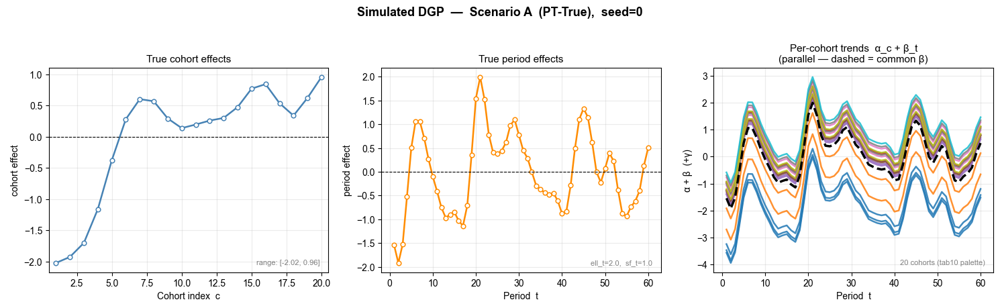

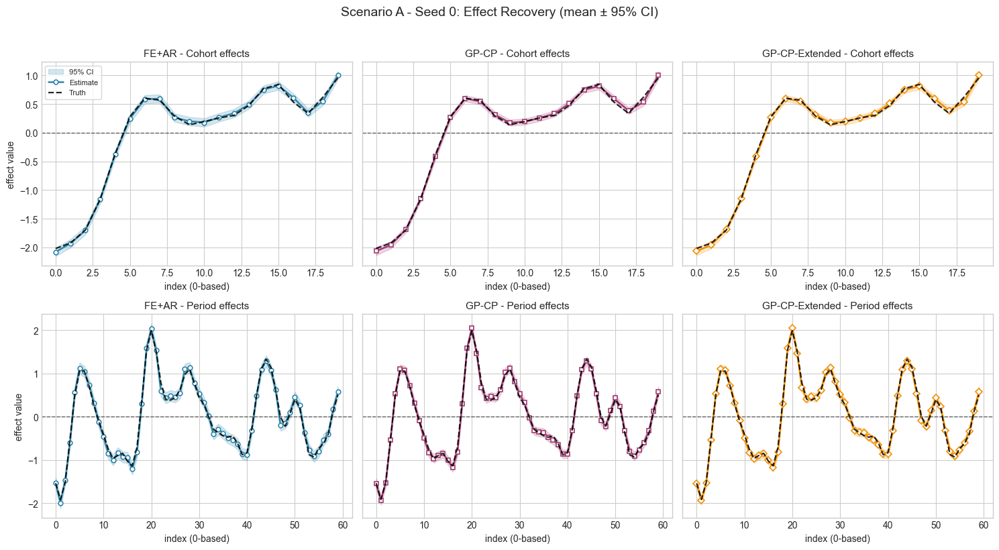

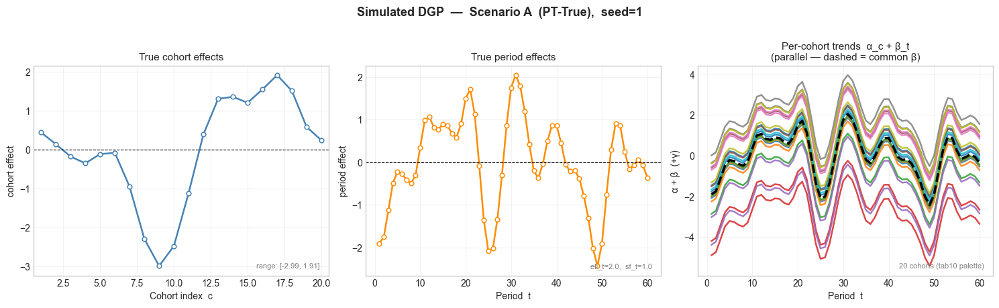

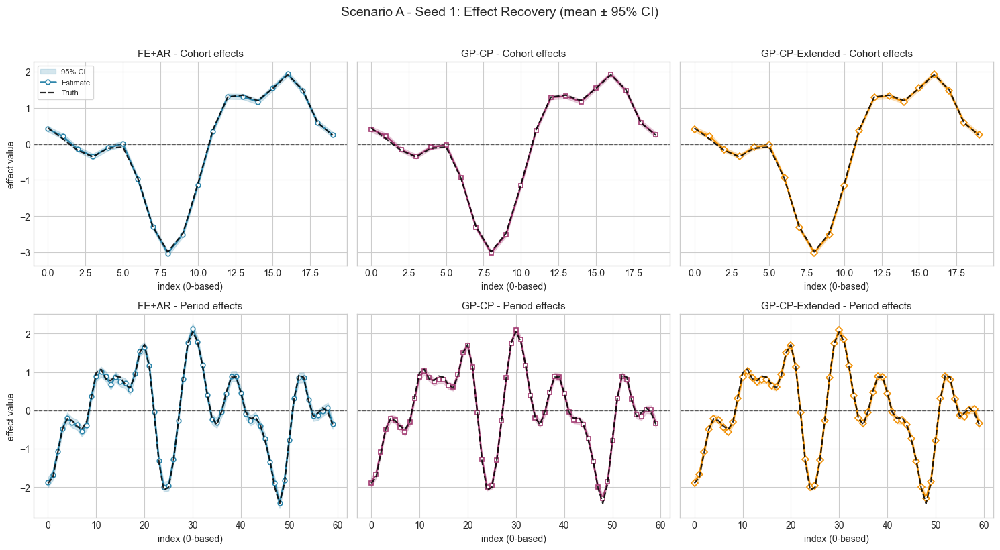

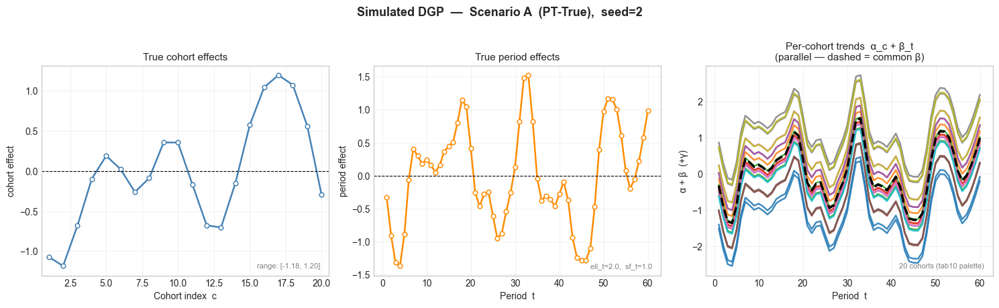

...

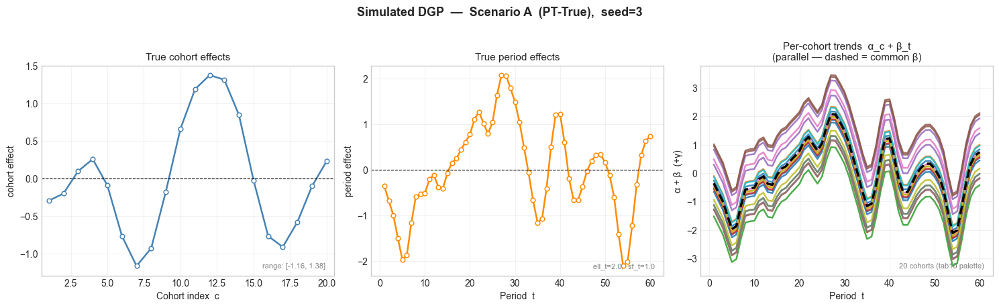

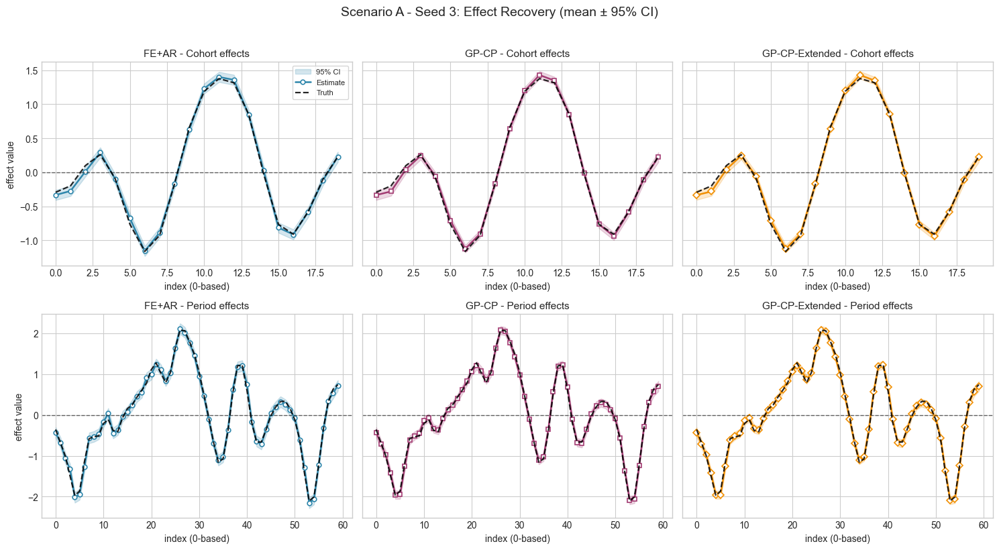

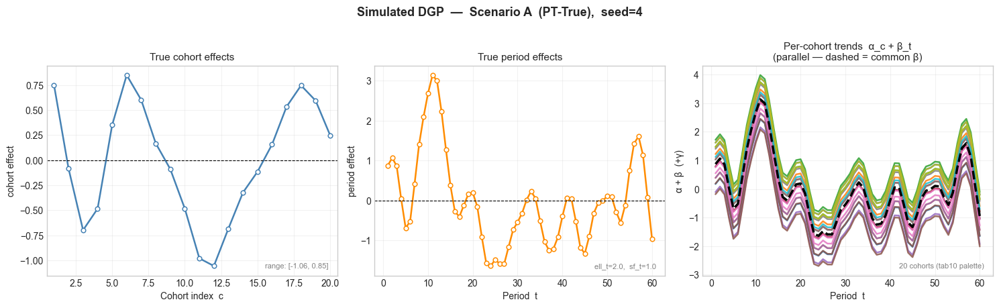

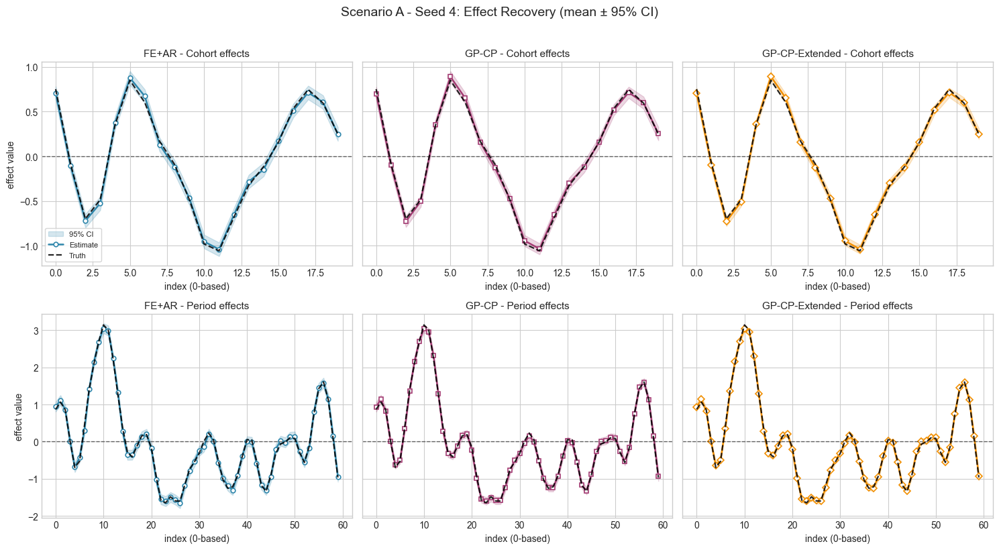

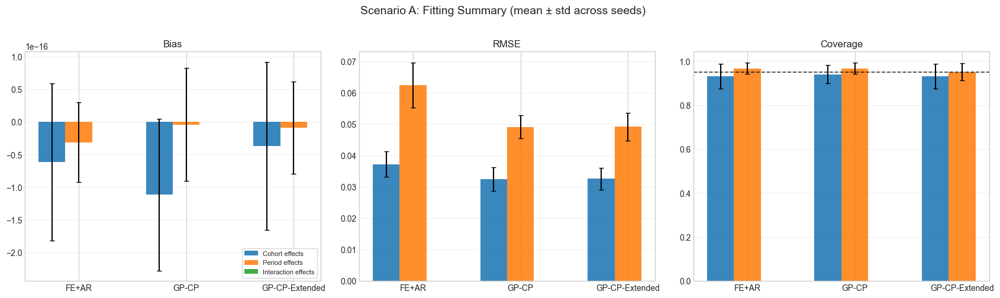

In [3]:
scenA_fit_records = []
scenA_metric_records = []

for seed in SEEDS:
 data = simulate_cohort_data(
  n_cohorts=N_COHORTS,
  n_periods=N_PERIODS,
  n_reps=N_REPS,
  ell_c=ELL_C, sf_c=SF_C,
  ell_t=ELL_T, sf_t=SF_T,
  sn=SN,
  interaction=False,
  seed=seed,
 )

 seed_dir = _scenario_seed_dir('A', seed)

 report_path = seed_dir / f'dgp_report_seed{seed}.txt'
 _write_seed_dgp_report(data, scenario_label='A', out_path=report_path)
 plot_simulated_data(
  data,
  print_config=False,
  save_path=str(seed_dir / f'dgp_overview_seed{seed}.pdf'),
 )

 fitted = _fit_models_full_data(data, use_global_mean=False)

 seed_rows = []
 for model_label, model_out in fitted.items:
  seed_rows.extend(_build_fit_rows(model_label, model_out, data, include_gamma=False))
 seed_df = pd.DataFrame(seed_rows)
 fit_csv = seed_dir / f'scenA_fit_seed{seed}.csv'
 seed_df.to_csv(fit_csv, index=False)

 seed_metrics = _build_seed_fit_metrics(seed_df)
 seed_metrics.to_csv(seed_dir / f'scenA_fit_metrics_seed{seed}.csv', index=False)
 (seed_dir / f'scenA_fit_metrics_seed{seed}.txt').write_text(seed_metrics.to_string(index=False) + '\n')

 fit_info = _fit_info_for_plots(data, fitted)
 model_cmp_df, residual_df = build_comparison_tables(fit_info, include_interaction=False)
 model_cmp_df.to_csv(seed_dir / f'model_fit_summary_seed{seed}.csv', index=False)
 residual_df.to_csv(seed_dir / f'residual_summary_seed{seed}.csv', index=False)

 plot_effect_recovery(
  seed_df,
  scenario='A',
  seed=seed,
  fit_info=fit_info,
  save_path=str(seed_dir / f'scenA_seed{seed}_effect_recovery.pdf'),
 )

 scenA_fit_records.append(seed_df.assign(seed=seed))
 scenA_metric_records.append(seed_metrics.assign(seed=seed))

 print(f'[A-1] seed={seed}: artifacts written to {seed_dir}')

scenA_fit_all = pd.concat(scenA_fit_records, ignore_index=True)
scenA_fit_metrics_all = pd.concat(scenA_metric_records, ignore_index=True)

summary_scenA_fit = (
 scenA_fit_metrics_all
.groupby(['model', 'effect_type', 'metric'], as_index=False)['value']
.agg(mean='mean', std='std')
)
summary_scenA_fit.to_csv(SIM_ROOT / 'summary_scenA_fit.csv', index=False)

plot_scenario_fit_summary(
 summary_scenA_fit,
 scenario='A',
 save_path=str(SIM_ROOT / 'summary_scenA_fit.pdf'),
)

summary_scenA_fit_wide = summary_scenA_fit.pivot_table(
 index=['model', 'effect_type'],
 columns='metric',
 values='mean',
 aggfunc='first',
).reset_index
summary_scenA_fit_wide.to_csv(SIM_ROOT / 'summary_scenA_fit_wide.csv', index=False)

print('\nA-1 complete.')
print('Wrote:', SIM_ROOT / 'summary_scenA_fit.csv')
display(summary_scenA_fit.head(20))


### A-2 Extrapolation
- Step: Fit on training periods and extrapolate to held-out periods.
- Save: Extrapolated period effects and error metrics.


Figure saved ->../results/simulations/A/0/scenA_seed0_placebo_tau_t.pdf
Figure saved ->../results/simulations/A/0/scenA_seed0_placebo_tau_ct.pdf
Figure saved ->../results/simulations/A/0/scenA_seed0_placebo_beta_diag.pdf
Figure saved ->../results/simulations/A/0/scenA_seed0_placebo_cohort_trends_3x3.pdf
[A-2] seed=0: extrapolation artifacts written to../results/simulations/A/0
Figure saved ->../results/simulations/A/1/scenA_seed1_placebo_tau_t.pdf
Figure saved ->../results/simulations/A/1/scenA_seed1_placebo_tau_ct.pdf
Figure saved ->../results/simulations/A/1/scenA_seed1_placebo_beta_diag.pdf
Figure saved ->../results/simulations/A/1/scenA_seed1_placebo_cohort_trends_3x3.pdf
[A-2] seed=1: extrapolation artifacts written to../results/simulations/A/1
Figure saved ->../results/simulations/A/2/scenA_seed2_placebo_tau_t.pdf
Figure saved ->../results/simulations/A/2/scenA_seed2_placebo_tau_ct.pdf
Figure saved ->../results/simulations/A/2/scenA_seed2_placebo_beta_diag.pdf
Figure saved ->../r

,model,metric,value,seed
0,FE+AR,MAE,0.777031,0
1,FE+AR,MAPE,1726.298679,0
2,FE+AR,RMSE,0.909558,0
3,FE+AR,Coverage,1.000000,0
4,FE+AR,CI_Width,3.176326,0
5,GP-CP,MAE,0.346519,0
6,GP-CP,MAPE,423.763494,0
7,GP-CP,RMSE,0.412927,0
8,GP-CP,Coverage,1.000000,0
9,GP-CP,CI_Width,2.816723,0


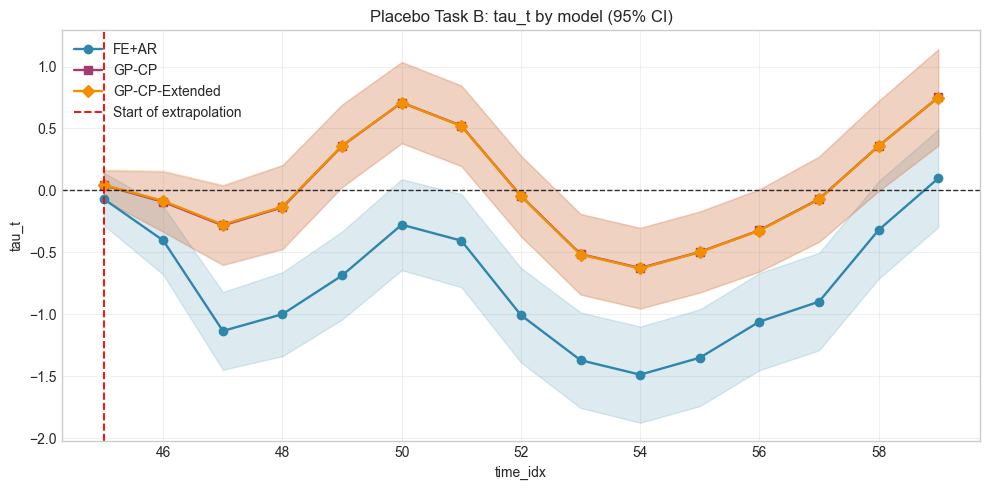

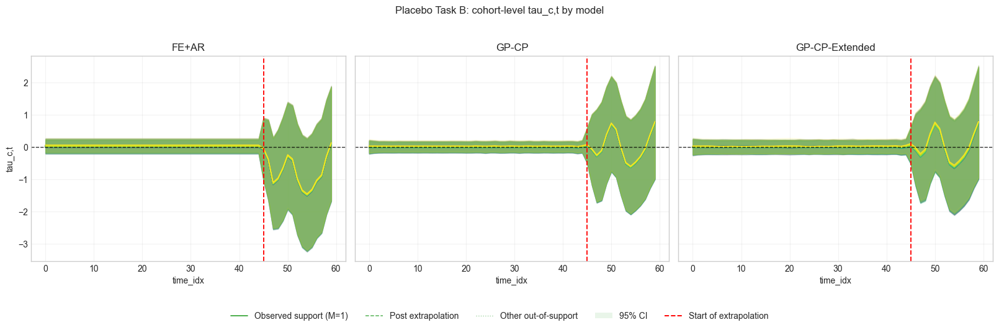

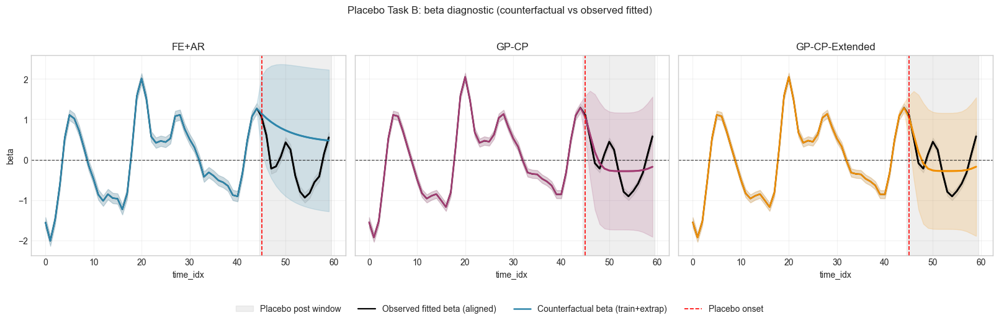

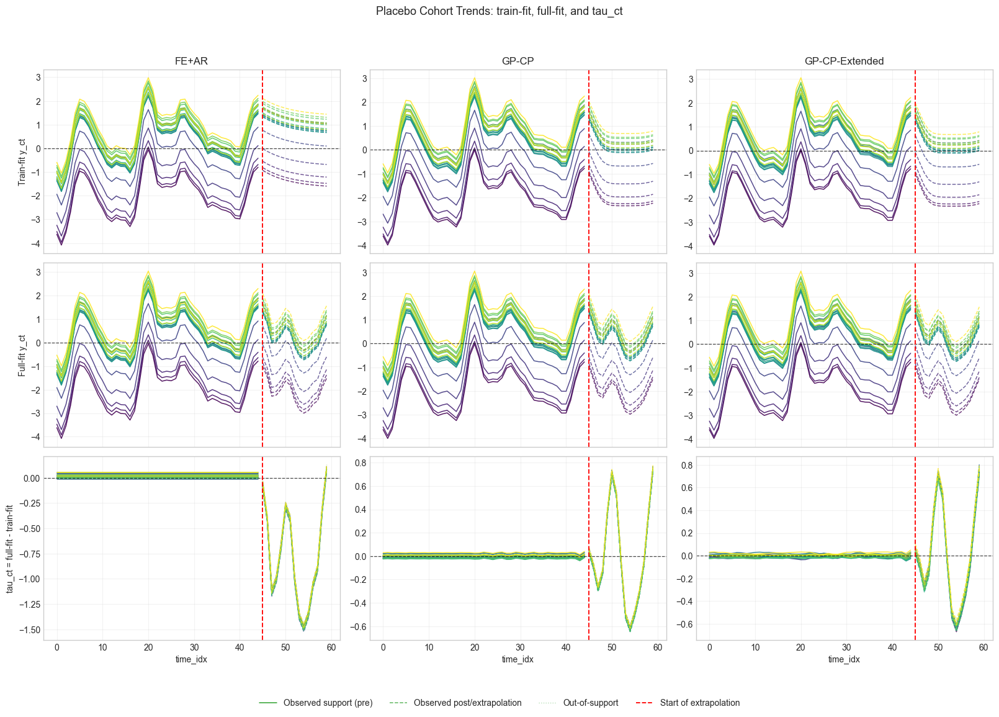

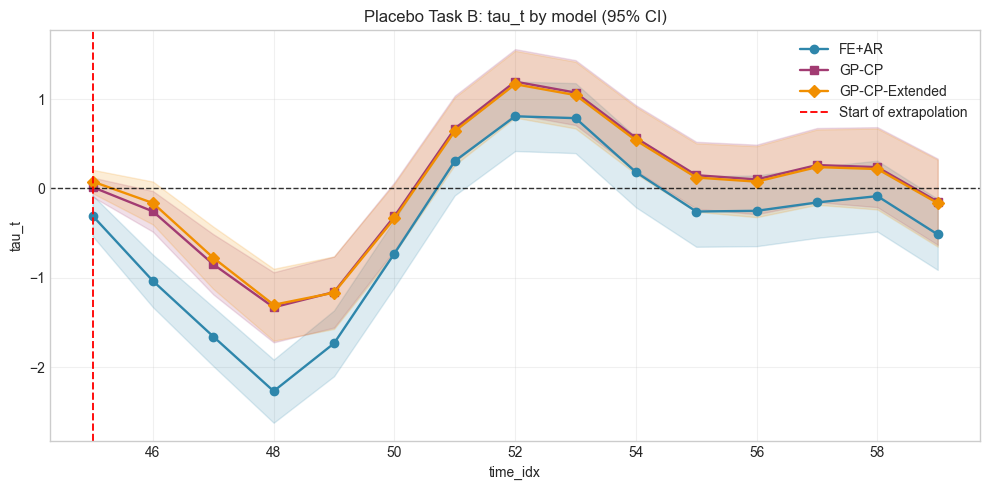

...

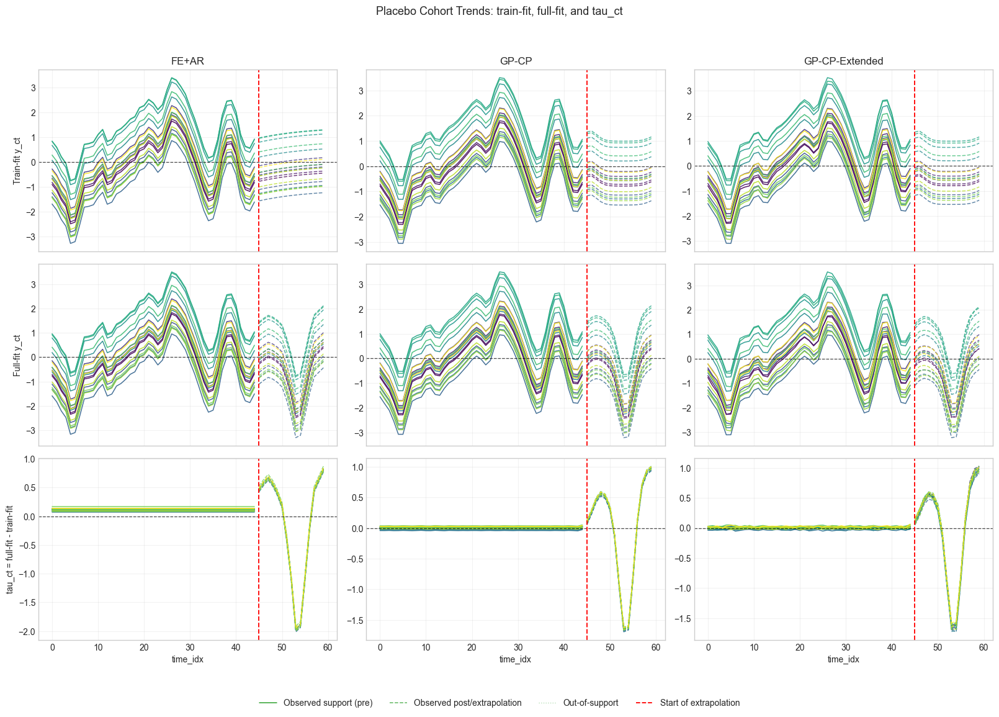

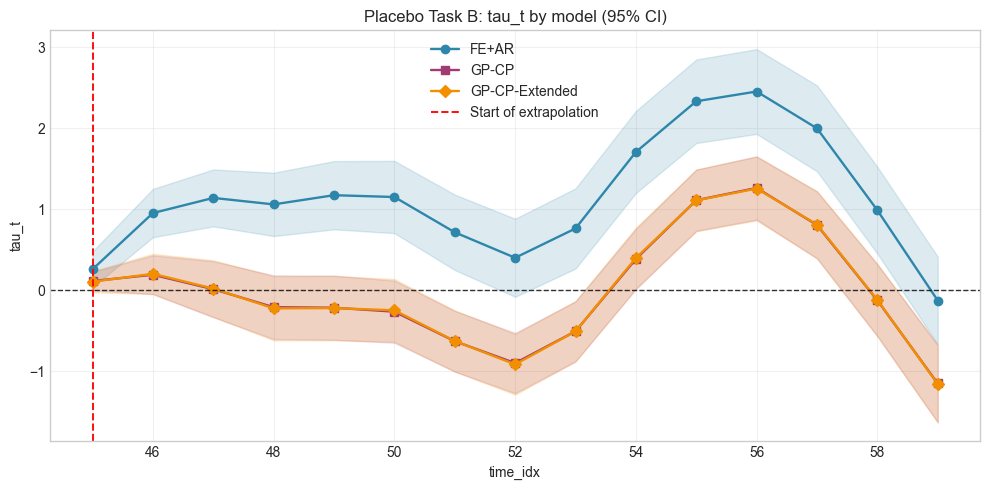

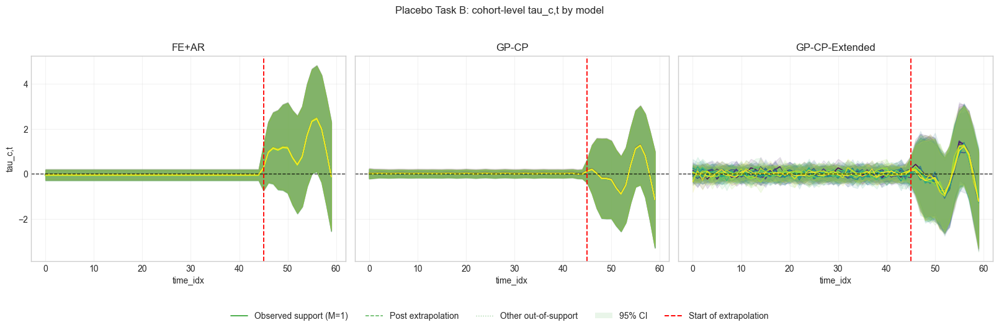

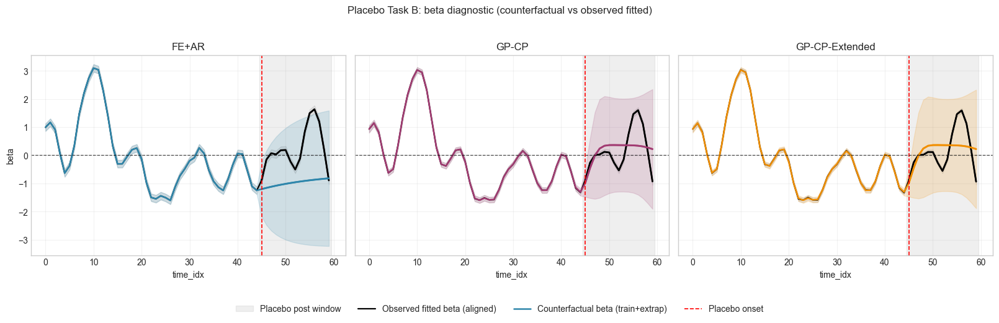

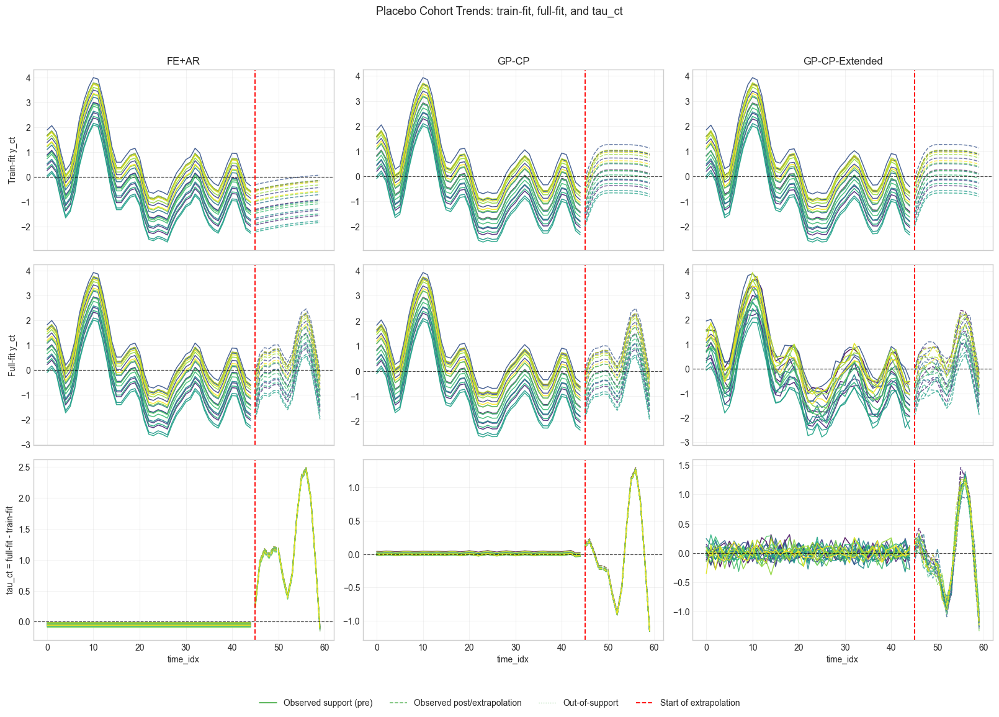

In [4]:
from src.visualization import plot_extrapolation

scenA_extrap_records = []
scenA_extrap_metric_records = []
scenA_extrap_y_records = []
scenA_extrap_y_metric_records = []
scenA_placebo_metric_records = []

for seed in SEEDS:
 data = simulate_cohort_data(
  n_cohorts=N_COHORTS,
  n_periods=N_PERIODS,
  n_reps=N_REPS,
  ell_c=ELL_C, sf_c=SF_C,
  ell_t=ELL_T, sf_t=SF_T,
  sn=SN,
  interaction=False,
  seed=seed,
 )

 seed_dir = _scenario_seed_dir('A', seed)
 obs_t = _to_numpy(data['obs_t']).astype(int)
 obs_c = _to_numpy(data['obs_c']).astype(int)
 y_all = _to_numpy(data['y']).astype(float)
 train_mask = obs_t <= TRAIN_CUTOFF
 test_mask = ~train_mask

 y_tr = y_all[train_mask]
 c_tr = obs_c[train_mask]
 t_tr = obs_t[train_mask]

 y_test = y_all[test_mask]
 c_test = obs_c[test_mask]
 t_test = obs_t[test_mask]

 t_train = TRAIN_CUTOFF + 1
 test_periods = np.arange(t_train, N_PERIODS, dtype=int)
 n_extrap = len(test_periods)
 beta_true_full = _to_numpy(data['beta_true'])
 beta_true_test = beta_true_full[test_periods]

 hp = data['hyperparams']

 fe = FixedEffectsModel(use_global_mean=False).fit(
  y=y_tr,
  obs_c=c_tr,
  obs_t=t_tr,
  n_cohorts=N_COHORTS,
  n_periods=t_train,
  seed=seed,
  true_hyperparams=hp,
 )
 fe_mean, fe_std = fe.extrapolate(n_extrap)

 cp = CohortPeriodModel(use_global_mean=False).fit(
  y=y_tr,
  obs_c=c_tr,
  obs_t=t_tr,
  n_cohorts=N_COHORTS,
  n_periods=N_PERIODS,
  seed=seed,
  true_hyperparams=hp,
 ).results_dict

 ext = CohortPeriodExtendedModel(use_global_mean=False).fit(
  y=y_tr,
  obs_c=c_tr,
  obs_t=t_tr,
  n_cohorts=N_COHORTS,
  n_periods=N_PERIODS,
  seed=seed,
  true_hyperparams=hp,
 ).results_dict

 model_preds = {
  'FE+AR': {'mean': np.asarray(fe_mean, dtype=float), 'std': np.asarray(fe_std, dtype=float)},
  'GP-CP': {'mean': np.asarray(cp['beta'], dtype=float)[test_periods], 'std': np.asarray(cp['std_beta'], dtype=float)[test_periods]},
  'GP-CP-Extended': {'mean': np.asarray(ext['beta'], dtype=float)[test_periods], 'std': np.asarray(ext['std_beta'], dtype=float)[test_periods]},
 }

 seed_rows = []
 seed_metrics = []
 for model_label, pred in model_preds.items:
  mean = pred['mean']
  std = pred['std']
  lo95 = mean - 1.96 * std
  hi95 = mean + 1.96 * std

  for k, t in enumerate(test_periods):
   seed_rows.append({'model': model_label, 'period': int(t), 'mean': float(mean[k]), 'lo95': float(lo95[k]), 'hi95': float(hi95[k]), 'truth': float(beta_true_test[k])})

  m = summarise_extrapolation(pred_mean=mean, truth=beta_true_test)
  m['Coverage'] = float(np.mean((lo95 <= beta_true_test) & (beta_true_test <= hi95)))
  m['CI_Width'] = float(np.mean(hi95 - lo95))
  for metric_name, value in m.items:
   seed_metrics.append({'model': model_label, 'metric': metric_name, 'value': float(value)})

 # Held-out y extrapolation diagnostics
 y_pred = {
  'FE+AR': fe.mu_ + fe.alpha_[c_test] + np.asarray(fe_mean, dtype=float)[t_test - t_train],
  'GP-CP': float(cp.get('mu', 0.0)) + np.asarray(cp['alpha'])[c_test] + np.asarray(cp['beta'])[t_test] + np.asarray(cp['gamma'])[c_test, t_test],
  'GP-CP-Extended': float(ext.get('mu', 0.0)) + np.asarray(ext['alpha'])[c_test] + np.asarray(ext['beta'])[t_test] + np.asarray(ext['gamma'])[c_test, t_test],
 }

 y_rows = []
 y_metrics = []
 for model_label, yh in y_pred.items:
  resid = yh - y_test
  for i in range(len(y_test)):
   y_rows.append({
    'model': model_label,
    'cohort': int(c_test[i]),
    'period': int(t_test[i]),
    'y_true': float(y_test[i]),
    'y_hat': float(yh[i]),
    'resid': float(resid[i]),
   })
  y_metrics.extend([
   {'model': model_label, 'metric': 'Bias', 'value': float(np.mean(resid))},
   {'model': model_label, 'metric': 'MAE', 'value': float(np.mean(np.abs(resid)))},
   {'model': model_label, 'metric': 'RMSE', 'value': float(np.sqrt(np.mean(resid ** 2)))},
  ])

 seed_extrap_df = pd.DataFrame(seed_rows)
 seed_extrap_metrics_df = pd.DataFrame(seed_metrics)
 seed_y_df = pd.DataFrame(y_rows)
 seed_y_metrics_df = pd.DataFrame(y_metrics)

 seed_extrap_df.to_csv(seed_dir / f'scenA_extrap_seed{seed}.csv', index=False)
 seed_extrap_metrics_df.to_csv(seed_dir / f'scenA_extrap_metrics_seed{seed}.csv', index=False)
 (seed_dir / f'scenA_extrap_metrics_seed{seed}.txt').write_text(seed_extrap_metrics_df.to_string(index=False) + "\n")

 seed_y_df.to_csv(seed_dir / f'scenA_extrap_y_seed{seed}.csv', index=False)
 seed_y_metrics_df.to_csv(seed_dir / f'scenA_extrap_y_metrics_seed{seed}.csv', index=False)
 (seed_dir / f'scenA_extrap_y_metrics_seed{seed}.txt').write_text(seed_y_metrics_df.to_string(index=False) + "\n")

 scenA_extrap_records.append(seed_extrap_df.assign(seed=seed))
 scenA_extrap_metric_records.append(seed_extrap_metrics_df.assign(seed=seed))
 scenA_extrap_y_records.append(seed_y_df.assign(seed=seed))
 scenA_extrap_y_metric_records.append(seed_y_metrics_df.assign(seed=seed))

 
 # Placebo TE on extrapolation window (truth is 0)
 model_order = ['FE+AR', 'GP-CP', 'GP-CP-Extended']
 support_mask_sim = np.ones((N_COHORTS, N_PERIODS), dtype=bool)

 fe_train_beta = np.concatenate([np.asarray(fe.beta_, dtype=float), np.asarray(fe_mean, dtype=float)])
 fe_train_beta_std = np.concatenate([np.asarray(fe.std_beta_, dtype=float), np.asarray(fe_std, dtype=float)])
 train_fit = {
  'FE+AR': {
   'mu': float(fe.mu_),
   'alpha': np.asarray(fe.alpha_, dtype=float),
   'beta': fe_train_beta,
   'std_alpha': np.asarray(fe.std_alpha_, dtype=float),
   'std_beta': fe_train_beta_std,
   'gamma': np.zeros((N_COHORTS, N_PERIODS), dtype=float),
   'std_gamma': np.zeros((N_COHORTS, N_PERIODS), dtype=float),
  },
  'GP-CP': {
   'mu': float(cp.get('mu', 0.0)),
   'alpha': np.asarray(cp['alpha'], dtype=float),
   'beta': np.asarray(cp['beta'], dtype=float),
   'std_alpha': np.asarray(cp.get('std_alpha', np.zeros(N_COHORTS)), dtype=float),
   'std_beta': np.asarray(cp.get('std_beta', np.zeros(N_PERIODS)), dtype=float),
   'gamma': np.asarray(cp.get('gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
   'std_gamma': np.asarray(cp.get('std_gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
  },
  'GP-CP-Extended': {
   'mu': float(ext.get('mu', 0.0)),
   'alpha': np.asarray(ext['alpha'], dtype=float),
   'beta': np.asarray(ext['beta'], dtype=float),
   'std_alpha': np.asarray(ext.get('std_alpha', np.zeros(N_COHORTS)), dtype=float),
   'std_beta': np.asarray(ext.get('std_beta', np.zeros(N_PERIODS)), dtype=float),
   'gamma': np.asarray(ext.get('gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
   'std_gamma': np.asarray(ext.get('std_gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
  },
 }

 fe_full = FixedEffectsModel(use_global_mean=False).fit(
  y=y_all,
  obs_c=obs_c,
  obs_t=obs_t,
  n_cohorts=N_COHORTS,
  n_periods=N_PERIODS,
  seed=seed,
  true_hyperparams=hp,
 )
 cp_full = CohortPeriodModel(use_global_mean=False).fit(
  y=y_all,
  obs_c=obs_c,
  obs_t=obs_t,
  n_cohorts=N_COHORTS,
  n_periods=N_PERIODS,
  seed=seed,
  true_hyperparams=hp,
 ).results_dict
 ext_full = CohortPeriodExtendedModel(use_global_mean=False).fit(
  y=y_all,
  obs_c=obs_c,
  obs_t=obs_t,
  n_cohorts=N_COHORTS,
  n_periods=N_PERIODS,
  seed=seed,
  true_hyperparams=hp,
 ).results_dict

 full_fit = {
  'FE+AR': {
   'mu': float(fe_full.mu_),
   'alpha': np.asarray(fe_full.alpha_, dtype=float),
   'beta': np.asarray(fe_full.beta_, dtype=float),
   'std_alpha': np.asarray(fe_full.std_alpha_, dtype=float),
   'std_beta': np.asarray(fe_full.std_beta_, dtype=float),
   'gamma': np.zeros((N_COHORTS, N_PERIODS), dtype=float),
   'std_gamma': np.zeros((N_COHORTS, N_PERIODS), dtype=float),
  },
  'GP-CP': {
   'mu': float(cp_full.get('mu', 0.0)),
   'alpha': np.asarray(cp_full['alpha'], dtype=float),
   'beta': np.asarray(cp_full['beta'], dtype=float),
   'std_alpha': np.asarray(cp_full.get('std_alpha', np.zeros(N_COHORTS)), dtype=float),
   'std_beta': np.asarray(cp_full.get('std_beta', np.zeros(N_PERIODS)), dtype=float),
   'gamma': np.asarray(cp_full.get('gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
   'std_gamma': np.asarray(cp_full.get('std_gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
  },
  'GP-CP-Extended': {
   'mu': float(ext_full.get('mu', 0.0)),
   'alpha': np.asarray(ext_full['alpha'], dtype=float),
   'beta': np.asarray(ext_full['beta'], dtype=float),
   'std_alpha': np.asarray(ext_full.get('std_alpha', np.zeros(N_COHORTS)), dtype=float),
   'std_beta': np.asarray(ext_full.get('std_beta', np.zeros(N_PERIODS)), dtype=float),
   'gamma': np.asarray(ext_full.get('gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
   'std_gamma': np.asarray(ext_full.get('std_gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
  },
 }

 tau_t_df, tau_ct_df, _ = compute_beta_placebo_te_tables(
  category=f'scenA_seed{seed}',
  train_fit=train_fit,
  full_fit=full_fit,
  n_t_tr=t_train,
  n_t=N_PERIODS,
  n_c=N_COHORTS,
  support_mask=support_mask_sim,
  model_order=model_order,
 )
 te_summary_df = summarise_placebo_estimands(
  category=f'scenA_seed{seed}',
  tau_ct_df=tau_ct_df,
  tau_t_df=tau_t_df,
  model_order=model_order,
 )
 placebo_long_df = te_summary_df.melt(
  id_vars=['category', 'model'], var_name='metric', value_name='value'
 )

 tau_t_df.to_csv(seed_dir / f'scenA_placebo_tau_t_seed{seed}.csv', index=False)
 tau_ct_df.to_csv(seed_dir / f'scenA_placebo_tau_ct_seed{seed}.csv', index=False)
 te_summary_df.to_csv(seed_dir / f'scenA_placebo_summary_seed{seed}.csv', index=False)
 placebo_long_df.to_csv(seed_dir / f'scenA_placebo_metrics_long_seed{seed}.csv', index=False)
 if 'placebo_long_df' not in locals:
  placebo_long_df = pd.DataFrame(columns=['category', 'model', 'metric', 'value'])
 scenA_placebo_metric_records.append(placebo_long_df.assign(seed=seed))

 plot_placebo_tau_t_by_model_lines_ci(
  tau_t_df=tau_t_df,
  model_order=model_order,
  treatment_time_idx=t_train,
  treatment_label='Start of extrapolation',
  save_path=str(seed_dir / f'scenA_seed{seed}_placebo_tau_t.pdf'),
 )
 plot_placebo_tau_ct_extended_lines_ci(
  tau_ct_df=tau_ct_df,
  model_order=model_order,
  treatment_time_idx=t_train,
  treatment_label='Start of extrapolation',
  save_path=str(seed_dir / f'scenA_seed{seed}_placebo_tau_ct.pdf'),
 )
 plot_placebo_beta_diagnostic_3panel(
  train_fit=train_fit,
  full_fit=full_fit,
  n_t_tr=t_train,
  n_t=N_PERIODS,
  model_order=model_order,
  save_path=str(seed_dir / f'scenA_seed{seed}_placebo_beta_diag.pdf'),
 )
 plot_placebo_cohort_trends_3x3(
  train_fit=train_fit,
  full_fit=full_fit,
  support_mask=support_mask_sim,
  model_order=model_order,
  treatment_time_idx=t_train,
  treatment_label='Start of extrapolation',
  extrapolation_start_idx=t_train,
  save_path=str(seed_dir / f'scenA_seed{seed}_placebo_cohort_trends_3x3.pdf'),
 )

 print(f'[A-2] seed={seed}: extrapolation artifacts written to {seed_dir}')

scenA_extrap_all = pd.concat(scenA_extrap_records, ignore_index=True)
scenA_extrap_metrics_all = pd.concat(scenA_extrap_metric_records, ignore_index=True)
scenA_extrap_y_all = pd.concat(scenA_extrap_y_records, ignore_index=True)
scenA_extrap_y_metrics_all = pd.concat(scenA_extrap_y_metric_records, ignore_index=True)
scenA_placebo_metrics_all = pd.concat(scenA_placebo_metric_records, ignore_index=True)

summary_scenA_placebo = (
 scenA_placebo_metrics_all
.groupby(['model', 'metric'], as_index=False)['value']
.agg(mean='mean', std='std')
)
summary_scenA_placebo.to_csv(SIM_ROOT / 'summary_scenA_placebo.csv', index=False)

print("\nA-2 complete.")
print('Rows in scenA_extrap_all:', len(scenA_extrap_all))
print('Rows in scenA_extrap_y_all:', len(scenA_extrap_y_all))
display(scenA_extrap_metrics_all.head(12))


### A-3 Aggregate Metrics
- Step: Combine per-seed fitting and extrapolation metrics.
- Save: Scenario A summary CSV tables.


In [5]:
summary_scenA_extrap = (
 scenA_extrap_metrics_all
.groupby(['model', 'metric'], as_index=False)['value']
.agg(mean='mean', std='std')
)
summary_scenA_extrap.to_csv(SIM_ROOT / 'summary_scenA_extrap.csv', index=False)

summary_scenA_extrap_wide = summary_scenA_extrap.pivot_table(
 index='model', columns='metric', values='mean', aggfunc='first',
).reset_index
summary_scenA_extrap_wide.to_csv(SIM_ROOT / 'summary_scenA_extrap_wide.csv', index=False)

summary_scenA_extrap_y = (
 scenA_extrap_y_metrics_all
.groupby(['model', 'metric'], as_index=False)['value']
.agg(mean='mean', std='std')
)
summary_scenA_extrap_y.to_csv(SIM_ROOT / 'summary_scenA_extrap_y.csv', index=False)

print('A-3 complete.')
print('Wrote:', SIM_ROOT / 'summary_scenA_extrap.csv')
print('Wrote:', SIM_ROOT / 'summary_scenA_extrap_y.csv')
print('Wrote:', SIM_ROOT / 'summary_scenA_placebo.csv')

print("\nScenario A fit summary (from A-1):")
display(summary_scenA_fit.head(20))

print("\nScenario A beta-extrap summary (A-2 aggregated):")
display(summary_scenA_extrap)

print("\nScenario A held-out y extrap summary:")
display(summary_scenA_extrap_y)

print("\nScenario A placebo TE summary:")
display(summary_scenA_placebo)


A-3 complete.
Wrote:../results/simulations/summary_scenA_extrap.csv
Wrote:../results/simulations/summary_scenA_extrap_y.csv
Wrote:../results/simulations/summary_scenA_placebo.csv

Scenario A fit summary (from A-1):


,model,effect_type,metric,mean,std
0,FE+AR,alpha,Bias,-6.133982e-17,1.208898e-16
1,FE+AR,alpha,CI_Width,1.479905e-01,2.549025e-03
2,FE+AR,alpha,Coverage,9.300000e-01,5.700877e-02
3,FE+AR,alpha,RMSE,3.720194e-02,4.070014e-03
4,FE+AR,beta,Bias,-3.127128e-17,6.102949e-17
5,FE+AR,beta,CI_Width,2.607852e-01,4.491831e-03
6,FE+AR,beta,Coverage,9.666667e-01,2.635231e-02
7,FE+AR,beta,RMSE,6.243837e-02,7.179539e-03
8,FE+AR,gamma,Bias,NaN,NaN
9,FE+AR,gamma,Coverage,NaN,NaN



Scenario A beta-extrap summary (A-2 aggregated):


,model,metric,mean,std
0,FE+AR,CI_Width,3.328387,0.398898
1,FE+AR,Coverage,0.880000,0.086923
2,FE+AR,MAE,0.868051,0.159018
3,FE+AR,MAPE,709.855190,721.392203
4,FE+AR,RMSE,1.050242,0.165133
5,GP-CP,CI_Width,2.908283,0.328509
6,GP-CP,Coverage,0.973333,0.059628
7,GP-CP,MAE,0.514995,0.128051
8,GP-CP,MAPE,237.251812,126.176320
9,GP-CP,RMSE,0.628349,0.174963



Scenario A held-out y extrap summary:


,model,metric,mean,std
0,FE+AR,Bias,-0.132711,0.825656
1,FE+AR,MAE,0.887533,0.165751
2,FE+AR,RMSE,1.082297,0.171896
3,GP-CP,Bias,-0.003857,0.014010
4,GP-CP,MAE,0.560452,0.114814
5,GP-CP,RMSE,0.693260,0.149634
6,GP-CP-Extended,Bias,-0.003654,0.013933
7,GP-CP-Extended,MAE,0.556026,0.114195
8,GP-CP-Extended,RMSE,0.688861,0.148288



Scenario A placebo TE summary:


,model,metric,mean,std
0,FE+AR,att_avg_over_t,0.131752,0.827940
1,FE+AR,att_ci_width_avg_over_t,0.748568,0.088877
2,FE+AR,att_coverage_vs_zero,0.200000,0.447214
3,FE+AR,att_mae_vs_zero,0.666439,0.389880
4,FE+AR,att_rmse_vs_zero,0.666439,0.389880
5,FE+AR,tau_ci_width_avg_over_cohorts,1.171363,0.103495
6,FE+AR,tau_ci_width_std_over_cohorts,1.299435,0.184458
7,FE+AR,tau_coverage_avg_over_cohorts,0.966500,0.020961
8,FE+AR,tau_mae_avg_over_cohorts,0.280489,0.043957
9,FE+AR,tau_rmse_avg_over_cohorts,0.283210,0.043398


### A-4 Plots
- Step: Plot effect recovery and extrapolation trajectories for Scenario A.
- Save: Scenario A diagnostic figures.


Figure saved ->../results/simulations/A/0/scenA_seed0_effect_recovery.pdf
Figure saved ->../results/simulations/A/0/scenA_seed0_extrapolation_beta.pdf
Figure saved ->../results/simulations/A/0/scenA_seed0_extrapolation_y.pdf
[A-4] seed=0: effect/beta-extrap/y-extrap plots + metrics table written
Figure saved ->../results/simulations/A/1/scenA_seed1_effect_recovery.pdf
Figure saved ->../results/simulations/A/1/scenA_seed1_extrapolation_beta.pdf
Figure saved ->../results/simulations/A/1/scenA_seed1_extrapolation_y.pdf
[A-4] seed=1: effect/beta-extrap/y-extrap plots + metrics table written
Figure saved ->../results/simulations/A/2/scenA_seed2_effect_recovery.pdf
Figure saved ->../results/simulations/A/2/scenA_seed2_extrapolation_beta.pdf
Figure saved ->../results/simulations/A/2/scenA_seed2_extrapolation_y.pdf
[A-4] seed=2: effect/beta-extrap/y-extrap plots + metrics table written
Figure saved ->../results/simulations/A/3/scenA_seed3_effect_recovery.pdf
Figure saved ->../results/simulatio

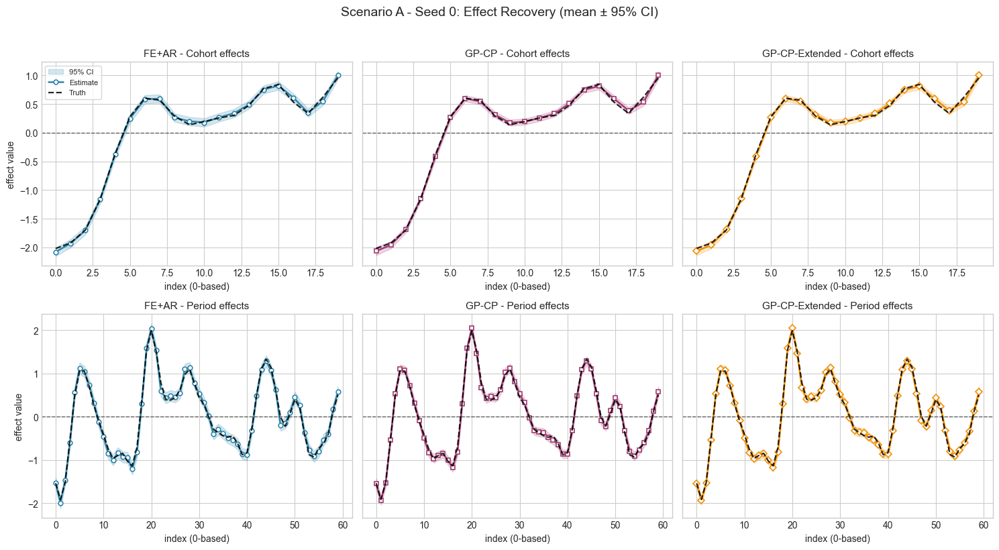

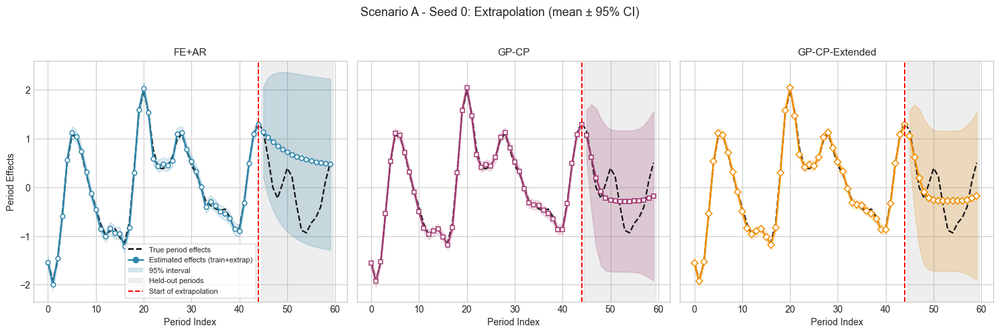

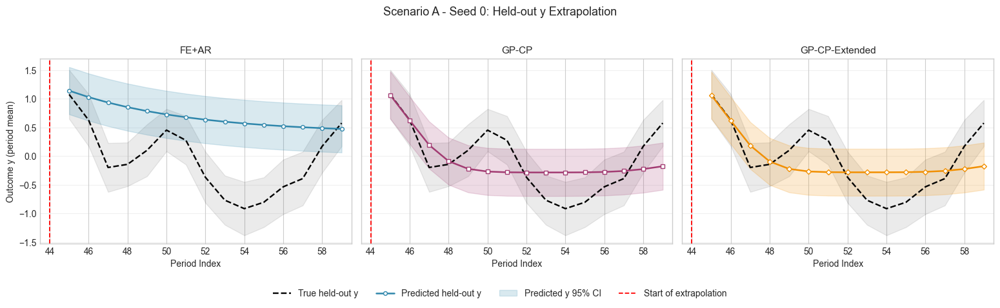

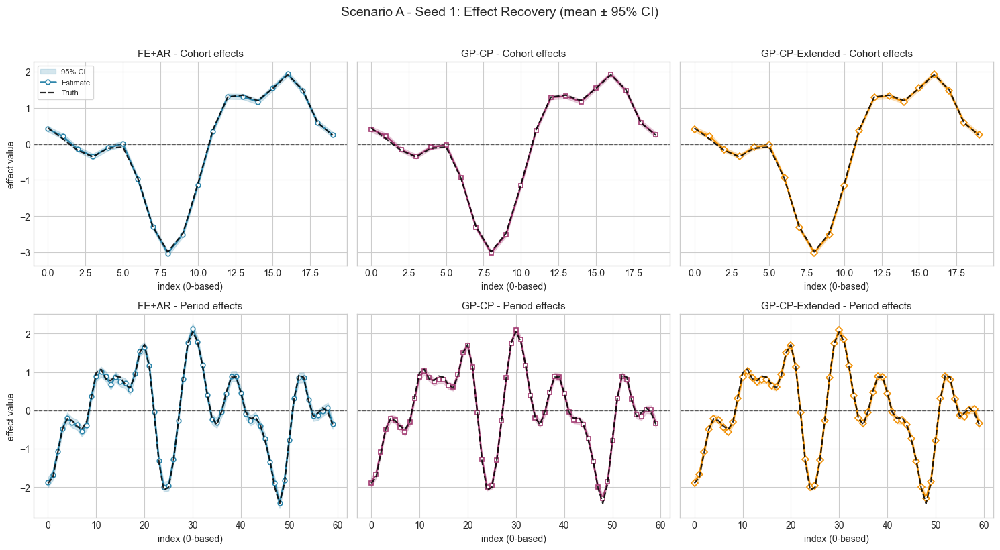

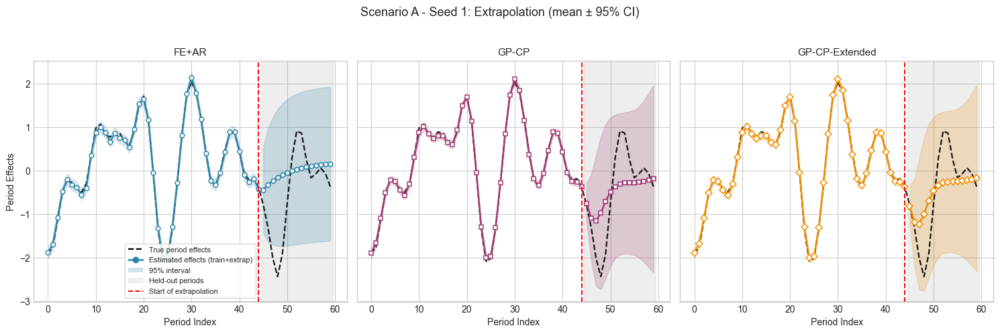

...

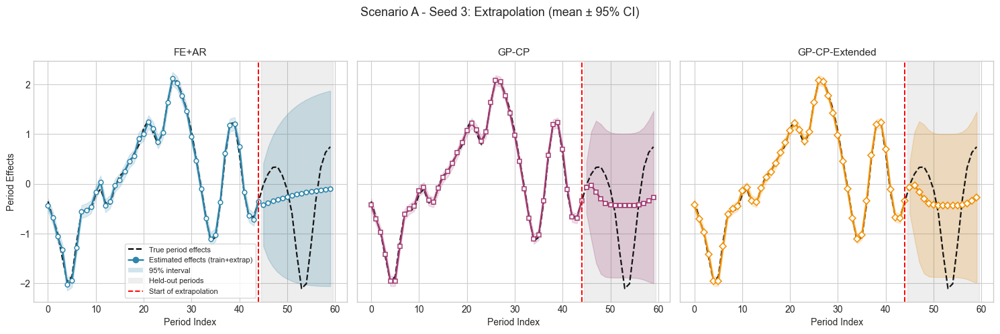

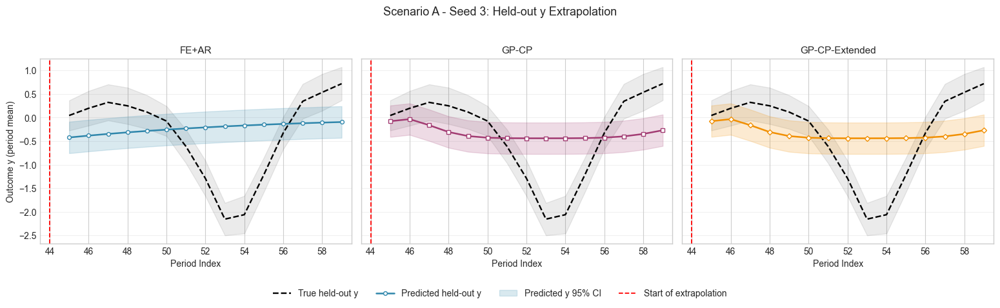

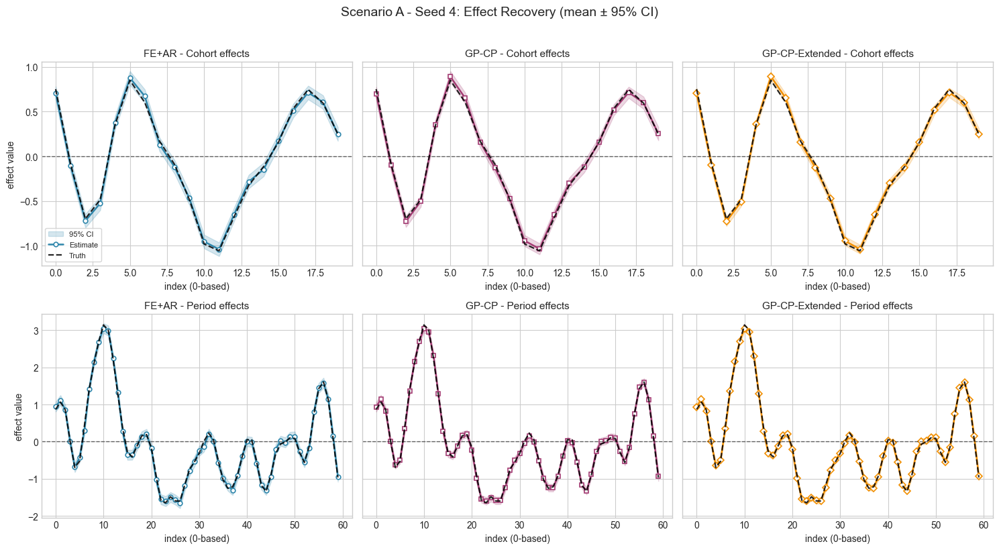

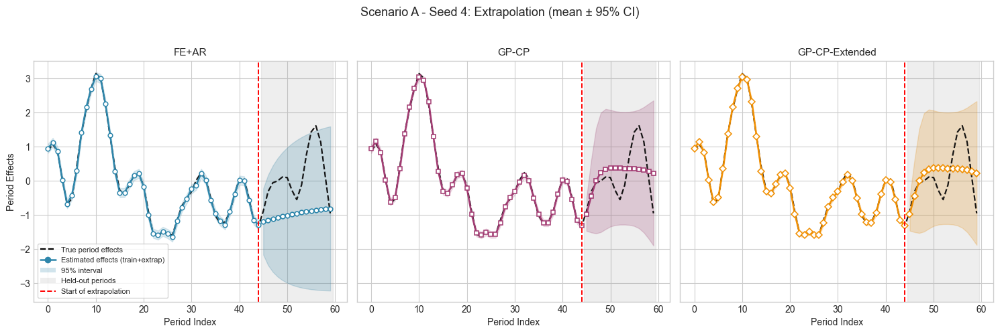

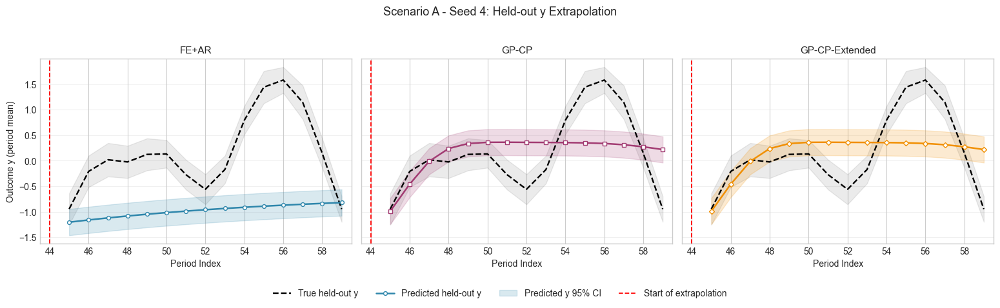

In [6]:
from src.visualization import plot_extrapolation, plot_extrapolation_y

for seed in SEEDS:
 seed_dir = _scenario_seed_dir('A', seed)

 fit_csv = seed_dir / f'scenA_fit_seed{seed}.csv'
 extrap_csv = seed_dir / f'scenA_extrap_seed{seed}.csv'
 y_extrap_csv = seed_dir / f'scenA_extrap_y_seed{seed}.csv'

 if not fit_csv.exists or not extrap_csv.exists or not y_extrap_csv.exists:
  print(f'[A-4] seed={seed}: missing fit/extrap CSV; skip plotting')
  continue

 fit_df = pd.read_csv(fit_csv)
 extrap_df = pd.read_csv(extrap_csv)
 y_extrap_df = pd.read_csv(y_extrap_csv)

 data = simulate_cohort_data(
  n_cohorts=N_COHORTS, n_periods=N_PERIODS, n_reps=N_REPS,
  ell_c=ELL_C, sf_c=SF_C, ell_t=ELL_T, sf_t=SF_T,
  sn=SN, interaction=False, seed=seed,
 )
 beta_true_full = _to_numpy(data['beta_true'])

 plot_effect_recovery(fit_df, scenario='A', seed=seed, fit_info=None,
       save_path=str(seed_dir / f'scenA_seed{seed}_effect_recovery.pdf'))

 plot_extrapolation(
  fit_df=fit_df,
  extrap_df=extrap_df,
  beta_true_full=beta_true_full,
  train_cutoff=TRAIN_CUTOFF,
  scenario='A',
  seed=seed,
  save_path=str(seed_dir / f'scenA_seed{seed}_extrapolation_beta.pdf'),
 )

 plot_extrapolation_y(
  extrap_y_df=y_extrap_df,
  train_cutoff=TRAIN_CUTOFF,
  scenario='A',
  seed=seed,
  save_path=str(seed_dir / f'scenA_seed{seed}_extrapolation_y.pdf'),
 )

 seed_fit_metrics = pd.read_csv(seed_dir / f'scenA_fit_metrics_seed{seed}.csv').assign(task='fit')
 seed_ex_metrics = pd.read_csv(seed_dir / f'scenA_extrap_metrics_seed{seed}.csv').assign(task='extrapolation', effect_type='beta')
 seed_ex_y_metrics = pd.read_csv(seed_dir / f'scenA_extrap_y_metrics_seed{seed}.csv').assign(task='extrapolation_y', effect_type='y')
 placebo_csv = seed_dir / f'scenA_placebo_metrics_long_seed{seed}.csv'
 if placebo_csv.exists:
  seed_placebo_metrics = pd.read_csv(placebo_csv)[['model', 'metric', 'value']].assign(task='placebo_te', effect_type='tau_att')
 else:
  seed_placebo_metrics = pd.DataFrame(columns=['model', 'metric', 'value', 'task', 'effect_type'])

 seed_model_table = pd.concat([seed_fit_metrics, seed_ex_metrics, seed_ex_y_metrics, seed_placebo_metrics], ignore_index=True)

 seed_model_table.to_csv(seed_dir / f'scenA_model_metrics_seed{seed}.csv', index=False)
 (seed_dir / f'scenA_model_metrics_seed{seed}.txt').write_text(seed_model_table.to_string(index=False) + "\n")

 print(f'[A-4] seed={seed}: effect/beta-extrap/y-extrap plots + metrics table written')

print("\nA-4 complete.")
print('Per-seed plots and model metric tables written under:', SIM_ROOT / 'A')


Figure saved ->../results/simulations/A/0/scenA_seed0_effect_recovery.pdf
Figure saved ->../results/simulations/A/0/scenA_seed0_extrapolation.pdf
[A-4] seed=0: effect/extrapolation plots + metrics table written
Figure saved ->../results/simulations/A/1/scenA_seed1_effect_recovery.pdf
Figure saved ->../results/simulations/A/1/scenA_seed1_extrapolation.pdf
[A-4] seed=1: effect/extrapolation plots + metrics table written
Figure saved ->../results/simulations/A/2/scenA_seed2_effect_recovery.pdf
Figure saved ->../results/simulations/A/2/scenA_seed2_extrapolation.pdf
[A-4] seed=2: effect/extrapolation plots + metrics table written
Figure saved ->../results/simulations/A/3/scenA_seed3_effect_recovery.pdf
Figure saved ->../results/simulations/A/3/scenA_seed3_extrapolation.pdf
[A-4] seed=3: effect/extrapolation plots + metrics table written
Figure saved ->../results/simulations/A/4/scenA_seed4_effect_recovery.pdf
Figure saved ->../results/simulations/A/4/scenA_seed4_extrapolation.pdf
[A-4] seed

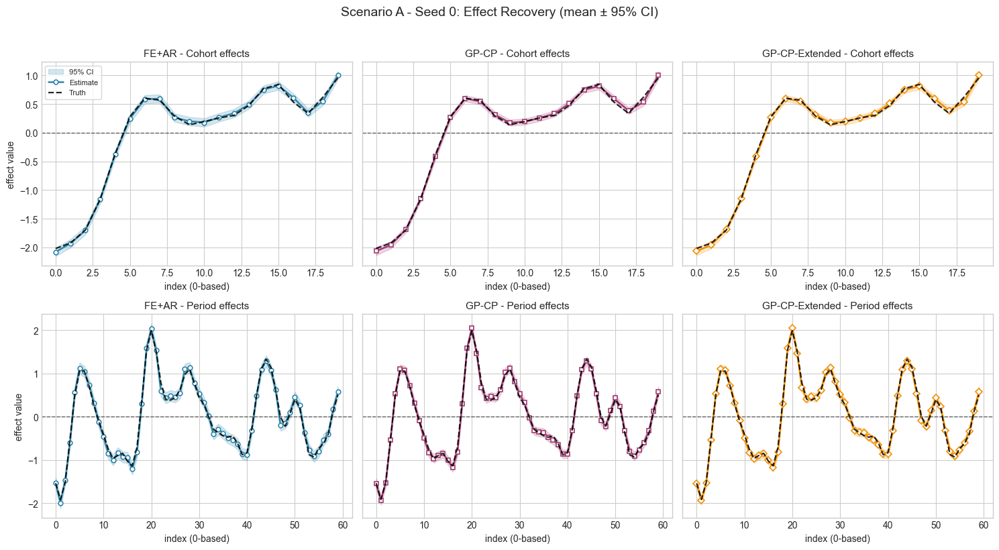

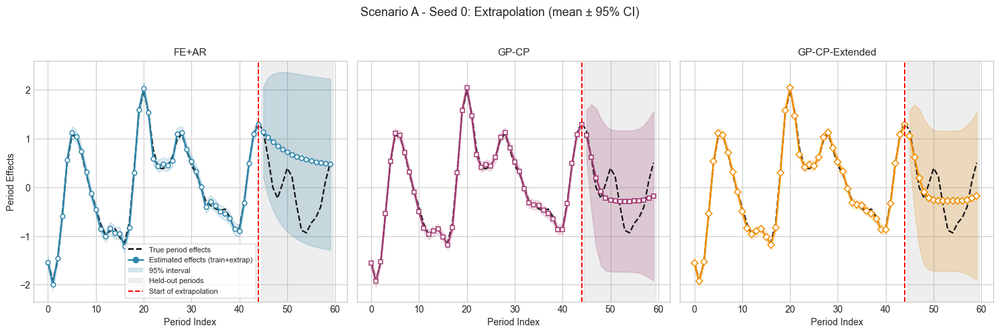

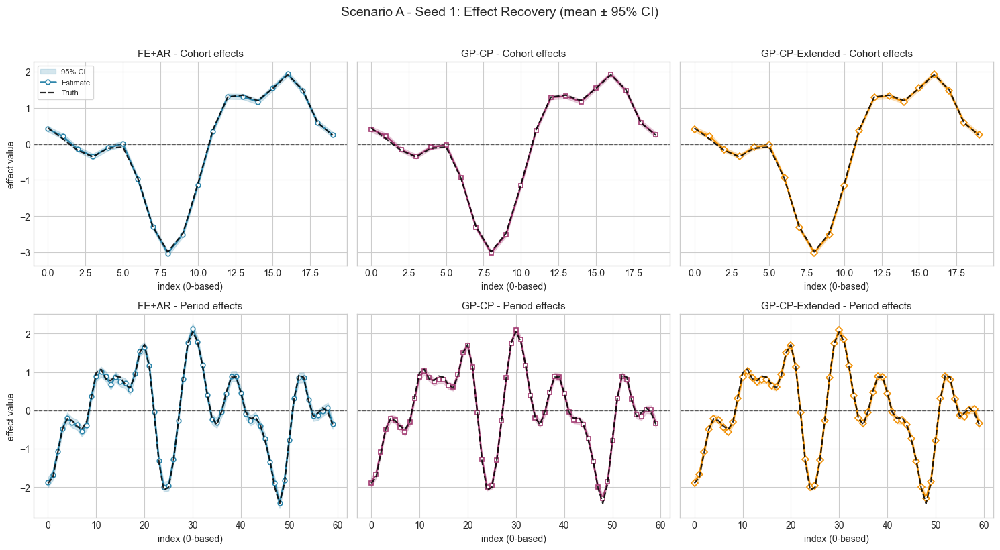

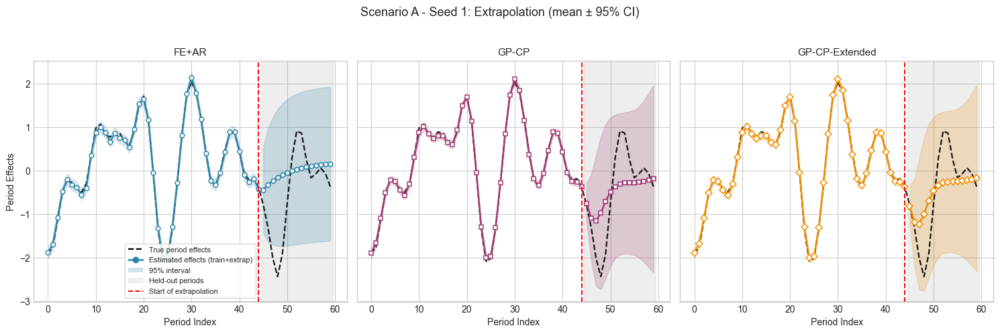

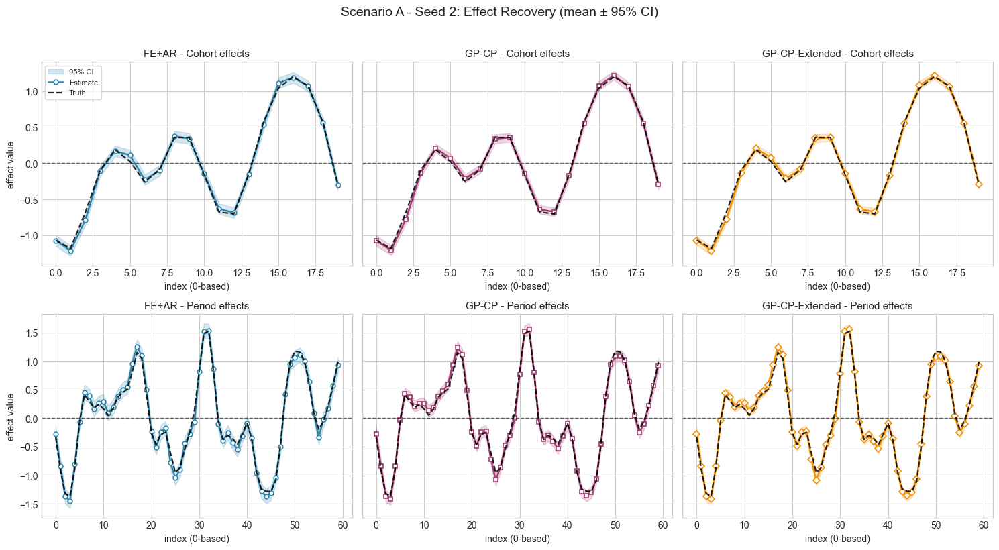

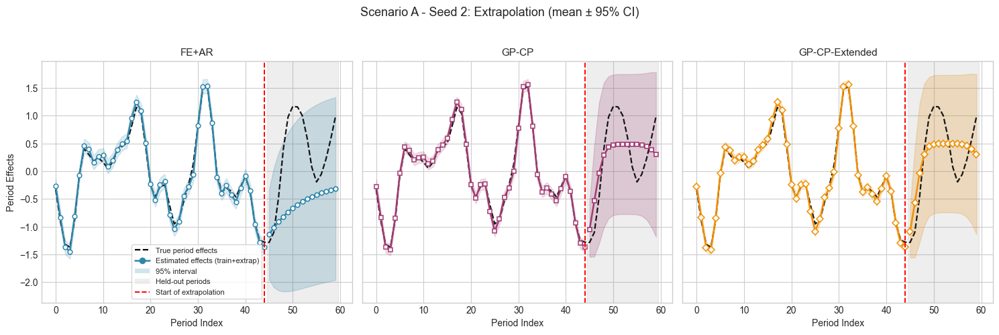

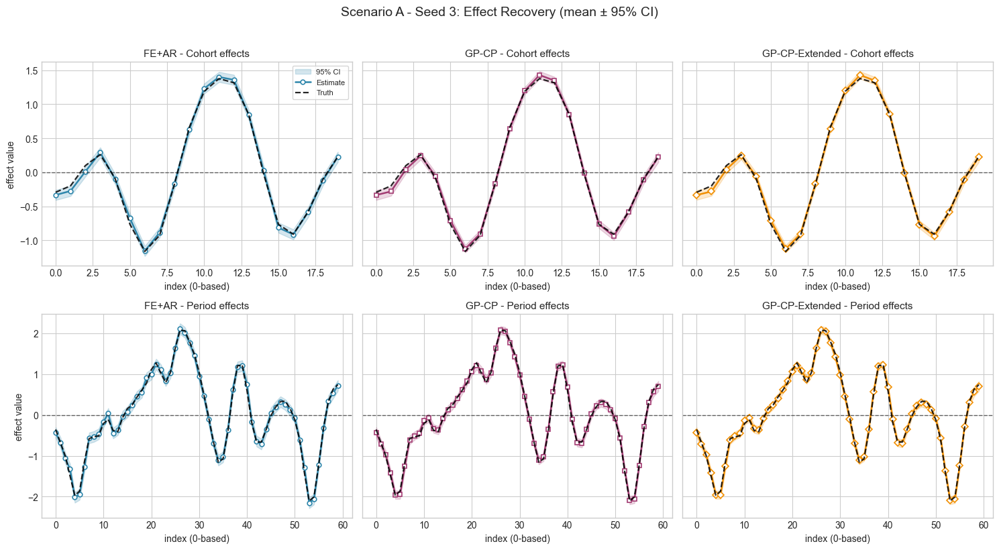

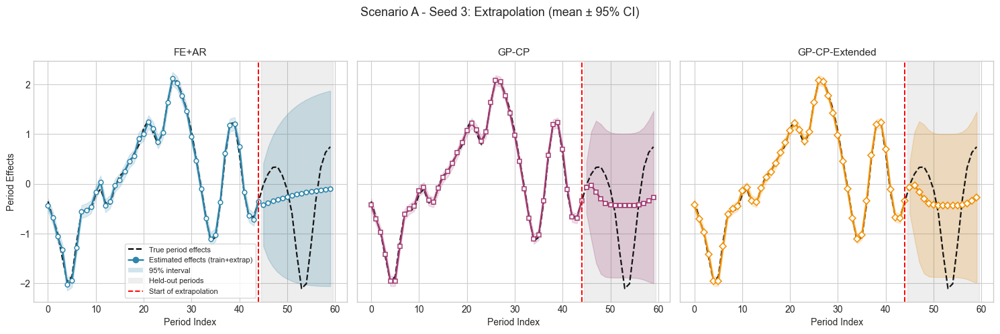

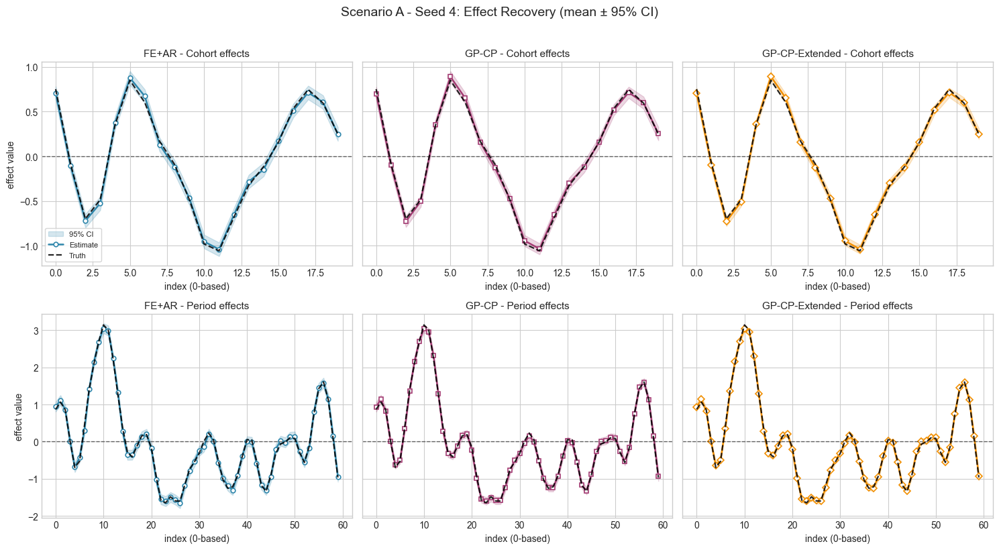

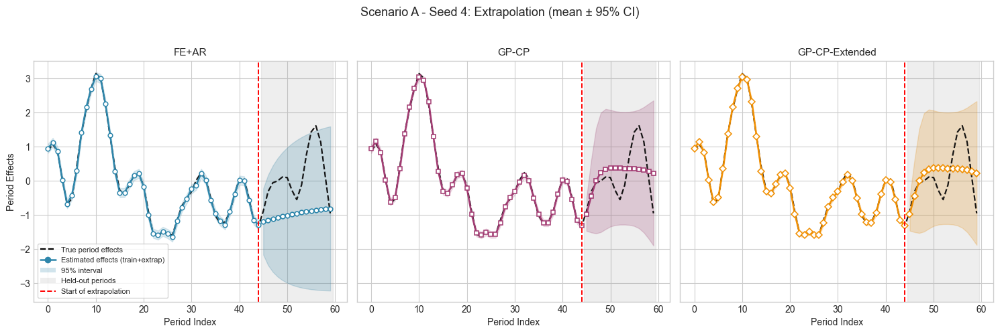

In [7]:
from src.visualization import plot_extrapolation

for seed in SEEDS:
 seed_dir = _scenario_seed_dir('A', seed)

 fit_csv = seed_dir / f'scenA_fit_seed{seed}.csv'
 extrap_csv = seed_dir / f'scenA_extrap_seed{seed}.csv'

 if not fit_csv.exists or not extrap_csv.exists:
  print(f'[A-4] seed={seed}: missing fit/extrap CSV; skip plotting')
  continue

 fit_df = pd.read_csv(fit_csv)
 extrap_df = pd.read_csv(extrap_csv)

 # Regenerate truth for the same seed so plots always match the saved seed artifacts.
 data = simulate_cohort_data(
  n_cohorts=N_COHORTS,
  n_periods=N_PERIODS,
  n_reps=N_REPS,
  ell_c=ELL_C, sf_c=SF_C,
  ell_t=ELL_T, sf_t=SF_T,
  sn=SN,
  interaction=False,
  seed=seed,
 )
 beta_true_full = _to_numpy(data['beta_true'])

 plot_effect_recovery(
  fit_df,
  scenario='A',
  seed=seed,
  fit_info=None,
  save_path=str(seed_dir / f'scenA_seed{seed}_effect_recovery.pdf'),
 )

 plot_extrapolation(
  fit_df=fit_df,
  extrap_df=extrap_df,
  beta_true_full=beta_true_full,
  train_cutoff=TRAIN_CUTOFF,
  scenario='A',
  seed=seed,
  save_path=str(seed_dir / f'scenA_seed{seed}_extrapolation.pdf'),
 )

 seed_fit_metrics = pd.read_csv(seed_dir / f'scenA_fit_metrics_seed{seed}.csv')
 seed_ex_metrics = pd.read_csv(seed_dir / f'scenA_extrap_metrics_seed{seed}.csv')
 seed_fit_metrics = seed_fit_metrics.assign(task='fit')
 seed_ex_metrics = seed_ex_metrics.assign(task='extrapolation', effect_type='beta')
 seed_model_table = pd.concat([seed_fit_metrics, seed_ex_metrics], ignore_index=True)

 seed_model_table.to_csv(seed_dir / f'scenA_model_metrics_seed{seed}.csv', index=False)
 (seed_dir / f'scenA_model_metrics_seed{seed}.txt').write_text(seed_model_table.to_string(index=False) + "\n")

 print(f'[A-4] seed={seed}: effect/extrapolation plots + metrics table written')

print("\nA-4 complete.")
print('Per-seed plots and model metric tables written under:', SIM_ROOT / 'A')


## Scenario B (With Interaction)
- Purpose: Evaluate robustness when parallel trends is violated.
- Output: Per-seed fit/extrapolation/placebo results and aggregated Scenario B tables.


### B-1 In-Sample Fitting
- Step: Fit all models on full Scenario B data for each seed.
- Save: Effect estimates and fitting metrics.


Figure saved →../results/simulations/B/0/dgp_overview_seed0.pdf


/path/to/your/project UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
 plt.tight_layout


Figure saved ->../results/simulations/B/0/scenB_seed0_effect_recovery.pdf
Figure saved ->../results/simulations/B/0/scenB_seed0_effect_recovery_residuals.pdf
Figure saved ->../results/simulations/B/0/scenB_seed0_effect_recovery_cohort_trends.pdf


/path/to/your/project UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
 fig.tight_layout(rect=[0, 0, 1, 0.96])


Figure saved ->../results/simulations/B/0/scenB_seed0_interaction_heatmap.pdf
[B-1] seed=0: artifacts written to../results/simulations/B/0
Figure saved →../results/simulations/B/1/dgp_overview_seed1.pdf


/path/to/your/project UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
 plt.tight_layout


Figure saved ->../results/simulations/B/1/scenB_seed1_effect_recovery.pdf
Figure saved ->../results/simulations/B/1/scenB_seed1_effect_recovery_residuals.pdf
Figure saved ->../results/simulations/B/1/scenB_seed1_effect_recovery_cohort_trends.pdf


/path/to/your/project UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
 fig.tight_layout(rect=[0, 0, 1, 0.96])


Figure saved ->../results/simulations/B/1/scenB_seed1_interaction_heatmap.pdf
[B-1] seed=1: artifacts written to../results/simulations/B/1
Figure saved →../results/simulations/B/2/dgp_overview_seed2.pdf


/path/to/your/project UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
 plt.tight_layout


Figure saved ->../results/simulations/B/2/scenB_seed2_effect_recovery.pdf
Figure saved ->../results/simulations/B/2/scenB_seed2_effect_recovery_residuals.pdf
Figure saved ->../results/simulations/B/2/scenB_seed2_effect_recovery_cohort_trends.pdf


/path/to/your/project UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
 fig.tight_layout(rect=[0, 0, 1, 0.96])


Figure saved ->../results/simulations/B/2/scenB_seed2_interaction_heatmap.pdf
[B-1] seed=2: artifacts written to../results/simulations/B/2
Figure saved →../results/simulations/B/3/dgp_overview_seed3.pdf


/path/to/your/project UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
 plt.tight_layout


Figure saved ->../results/simulations/B/3/scenB_seed3_effect_recovery.pdf
Figure saved ->../results/simulations/B/3/scenB_seed3_effect_recovery_residuals.pdf
Figure saved ->../results/simulations/B/3/scenB_seed3_effect_recovery_cohort_trends.pdf


/path/to/your/project UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
 fig.tight_layout(rect=[0, 0, 1, 0.96])
/path/to/your/project RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close`.
 fig = plt.figure(figsize=(15, 9))


Figure saved ->../results/simulations/B/3/scenB_seed3_interaction_heatmap.pdf
[B-1] seed=3: artifacts written to../results/simulations/B/3
Figure saved →../results/simulations/B/4/dgp_overview_seed4.pdf


/path/to/your/project UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
 plt.tight_layout


Figure saved ->../results/simulations/B/4/scenB_seed4_effect_recovery.pdf
Figure saved ->../results/simulations/B/4/scenB_seed4_effect_recovery_residuals.pdf
Figure saved ->../results/simulations/B/4/scenB_seed4_effect_recovery_cohort_trends.pdf
Figure saved ->../results/simulations/B/4/scenB_seed4_interaction_heatmap.pdf
[B-1] seed=4: artifacts written to../results/simulations/B/4


/path/to/your/project UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
 fig.tight_layout(rect=[0, 0, 1, 0.96])


Figure saved ->../results/simulations/summary_scenB_fit.pdf

B-1 complete.
Wrote:../results/simulations/summary_scenB_fit.csv


,model,effect_type,metric,mean,std
0,FE+AR,alpha,Bias,-5.273559e-18,1.046941e-16
1,FE+AR,alpha,CI_Width,4.678735e-01,1.849595e-02
2,FE+AR,alpha,Coverage,1.000000e+00,0.000000e+00
3,FE+AR,alpha,RMSE,3.246572e-02,4.944799e-03
4,FE+AR,beta,Bias,-8.465451e-18,4.083401e-17
5,FE+AR,beta,CI_Width,8.244753e-01,3.259311e-02
6,FE+AR,beta,Coverage,1.000000e+00,0.000000e+00
7,FE+AR,beta,RMSE,6.434038e-02,3.869010e-03
8,FE+AR,gamma,Bias,7.031412e-18,1.625802e-17
9,FE+AR,gamma,CI_Width,NaN,NaN


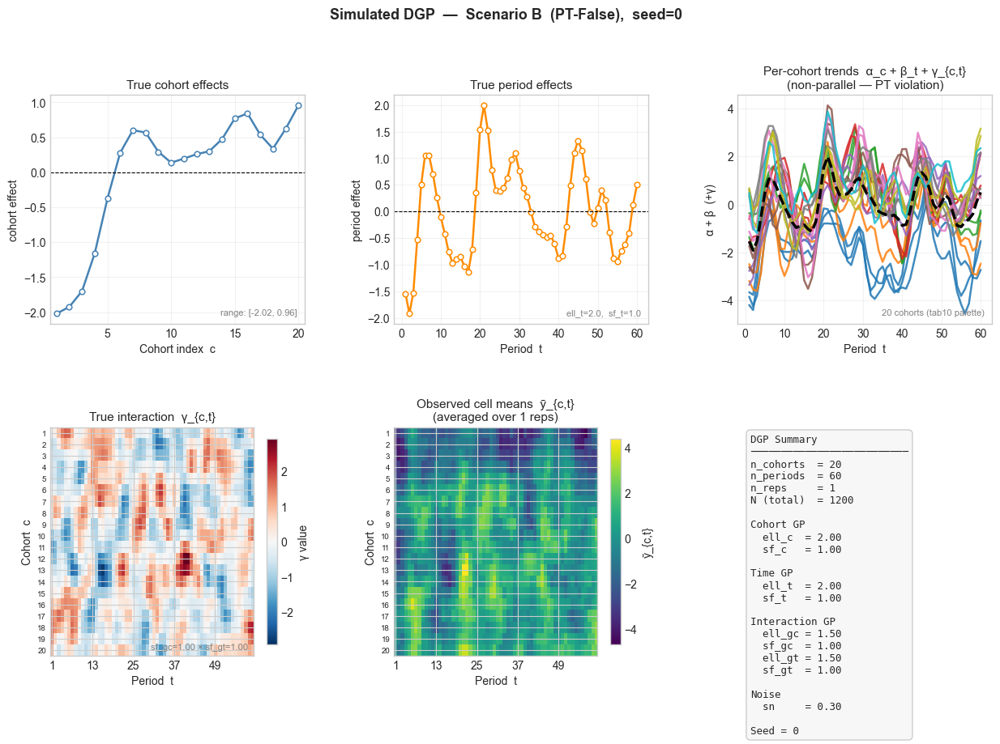

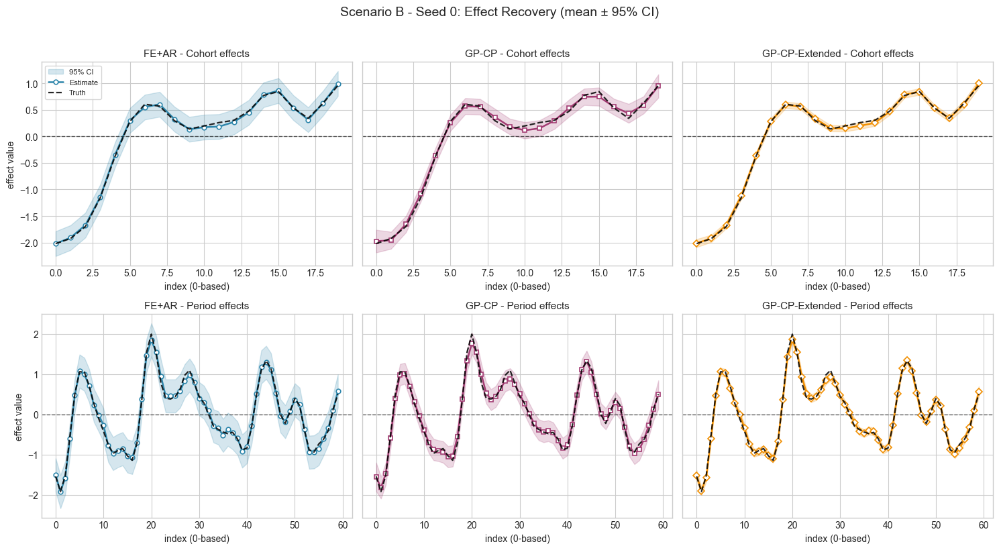

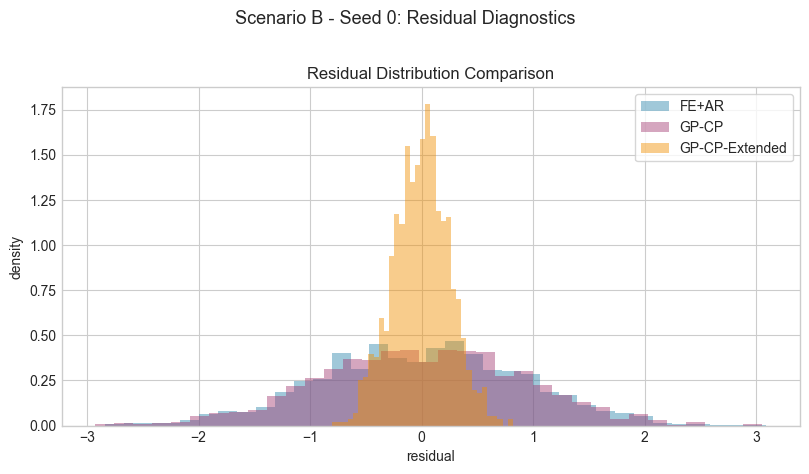

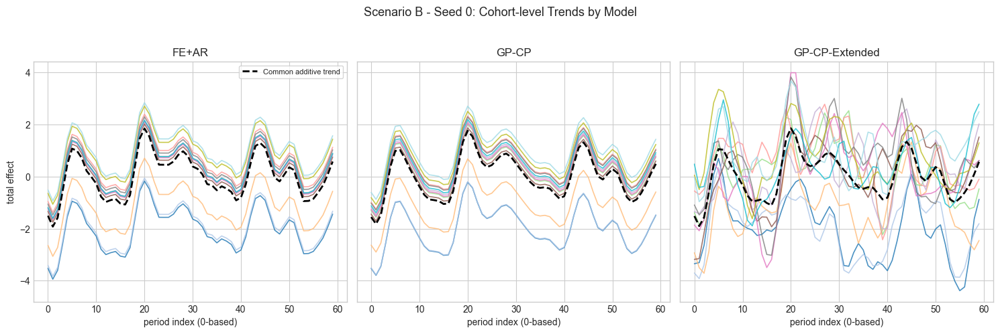

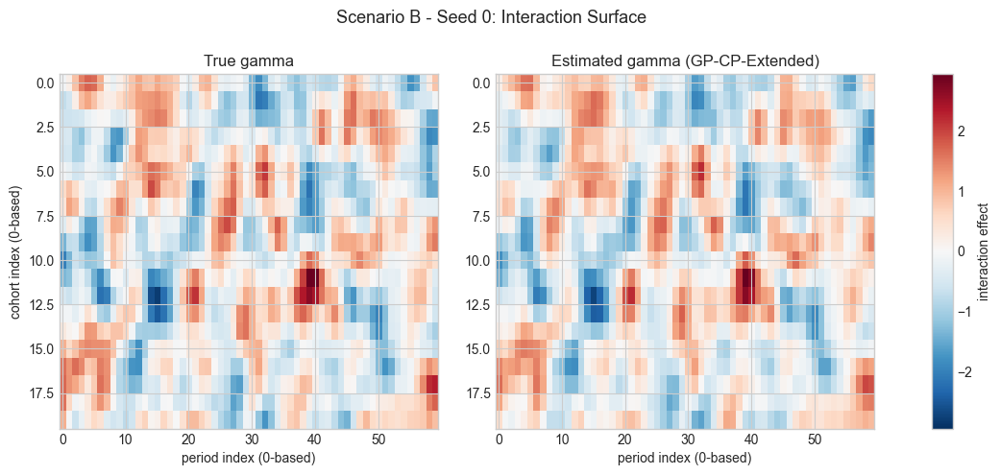

...

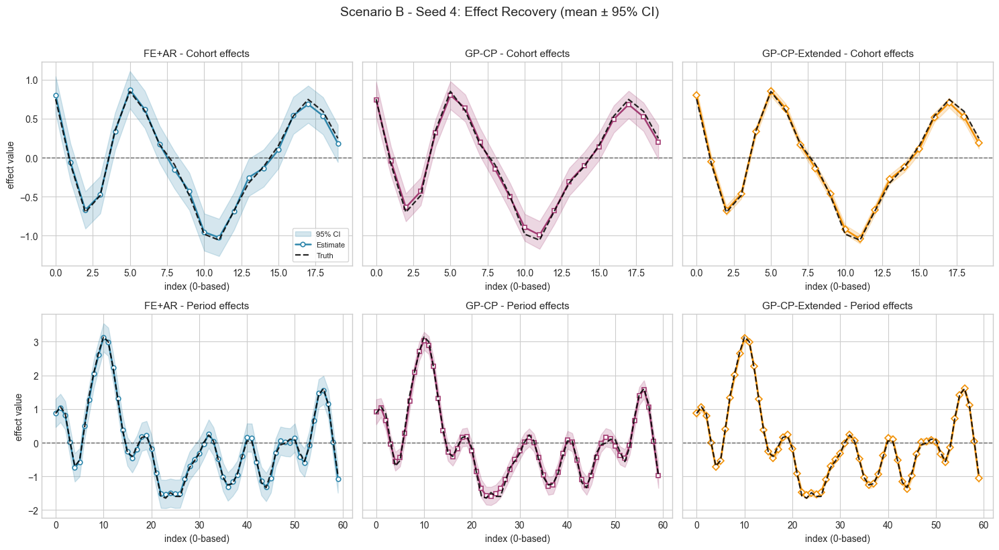

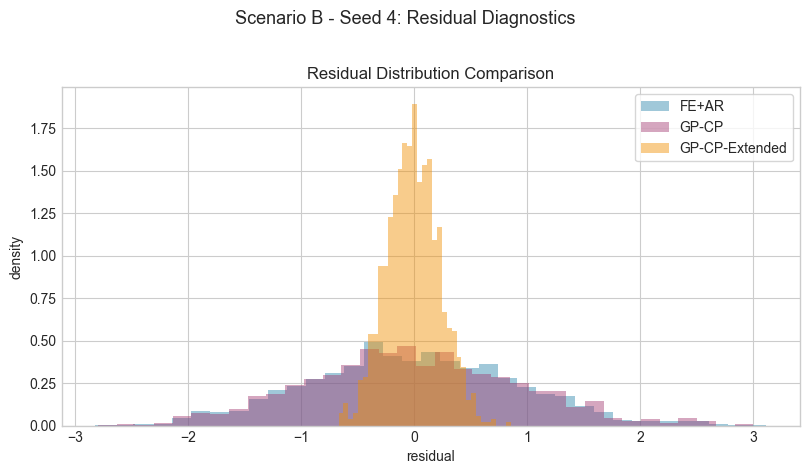

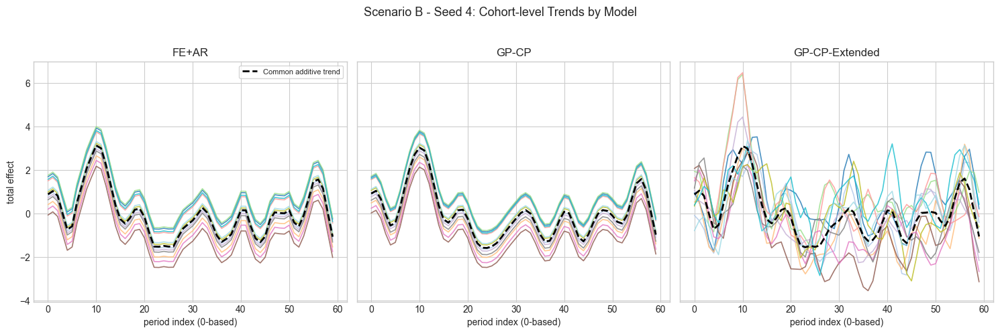

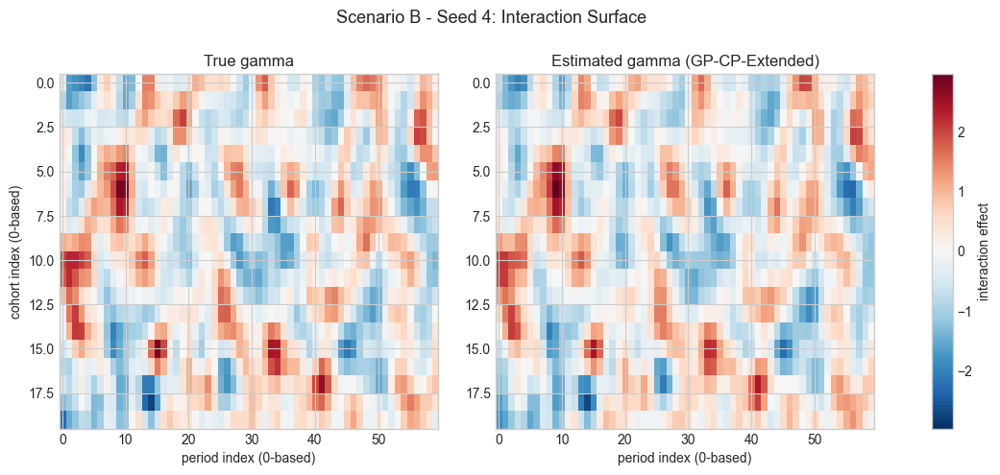

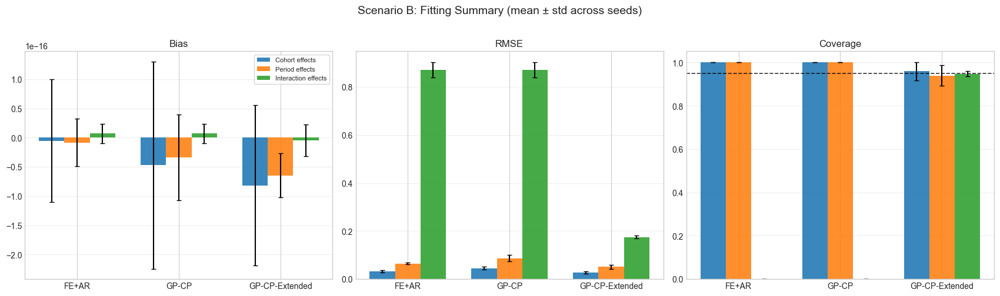

In [8]:
scenB_fit_records = []
scenB_metric_records = []

for seed in SEEDS:
 data = simulate_cohort_data(
  n_cohorts=N_COHORTS,
  n_periods=N_PERIODS,
  n_reps=N_REPS,
  ell_c=ELL_C, sf_c=SF_C,
  ell_t=ELL_T, sf_t=SF_T,
  ell_gc=ELL_GC, sf_gc=SF_GC,
  ell_gt=ELL_GT, sf_gt=SF_GT,
  sn=SN,
  interaction=True,
  seed=seed,
 )

 seed_dir = _scenario_seed_dir('B', seed)

 report_path = seed_dir / f'dgp_report_seed{seed}.txt'
 _write_seed_dgp_report(data, scenario_label='B', out_path=report_path)
 plot_simulated_data(
  data,
  print_config=False,
  save_path=str(seed_dir / f'dgp_overview_seed{seed}.pdf'),
 )

 fitted = _fit_models_full_data(data, use_global_mean=False)

 seed_rows = []
 for model_label, model_out in fitted.items:
  seed_rows.extend(_build_fit_rows(model_label, model_out, data, include_gamma=True))
 seed_df = pd.DataFrame(seed_rows)
 fit_csv = seed_dir / f'scenB_fit_seed{seed}.csv'
 seed_df.to_csv(fit_csv, index=False)

 seed_metrics = _build_seed_fit_metrics(seed_df)
 seed_metrics.to_csv(seed_dir / f'scenB_fit_metrics_seed{seed}.csv', index=False)
 (seed_dir / f'scenB_fit_metrics_seed{seed}.txt').write_text(seed_metrics.to_string(index=False) + "\n")

 fit_info = _fit_info_for_plots(data, fitted)
 model_cmp_df, residual_df = build_comparison_tables(fit_info, include_interaction=True)
 model_cmp_df.to_csv(seed_dir / f'model_fit_summary_seed{seed}.csv', index=False)
 residual_df.to_csv(seed_dir / f'residual_summary_seed{seed}.csv', index=False)

 plot_effect_recovery(
  seed_df,
  scenario='B',
  seed=seed,
  fit_info=fit_info,
  save_path=str(seed_dir / f'scenB_seed{seed}_effect_recovery.pdf'),
 )

 plot_interaction_heatmap(
  gamma_true=_to_numpy(data['gamma_true']),
  gamma_hat=np.asarray(fitted['GP-CP-Extended']['gamma']),
  scenario='B',
  seed=seed,
  save_path=str(seed_dir / f'scenB_seed{seed}_interaction_heatmap.pdf'),
 )

 scenB_fit_records.append(seed_df.assign(seed=seed))
 scenB_metric_records.append(seed_metrics.assign(seed=seed))

 print(f'[B-1] seed={seed}: artifacts written to {seed_dir}')

scenB_fit_all = pd.concat(scenB_fit_records, ignore_index=True)
scenB_fit_metrics_all = pd.concat(scenB_metric_records, ignore_index=True)

summary_scenB_fit = (
 scenB_fit_metrics_all
.groupby(['model', 'effect_type', 'metric'], as_index=False)['value']
.agg(mean='mean', std='std')
)
summary_scenB_fit.to_csv(SIM_ROOT / 'summary_scenB_fit.csv', index=False)

plot_scenario_fit_summary(
 summary_scenB_fit,
 scenario='B',
 save_path=str(SIM_ROOT / 'summary_scenB_fit.pdf'),
)

summary_scenB_fit_wide = summary_scenB_fit.pivot_table(
 index=['model', 'effect_type'],
 columns='metric',
 values='mean',
 aggfunc='first',
).reset_index
summary_scenB_fit_wide.to_csv(SIM_ROOT / 'summary_scenB_fit_wide.csv', index=False)

print('\nB-1 complete.')
print('Wrote:', SIM_ROOT / 'summary_scenB_fit.csv')
display(summary_scenB_fit.head(24))


### B-2 Extrapolation
- Step: Train on pre-cutoff periods and extrapolate post-cutoff periods.
- Save: Extrapolated effects and extrapolation metrics.


Figure saved ->../results/simulations/B/0/scenB_seed0_placebo_tau_t.pdf
Figure saved ->../results/simulations/B/0/scenB_seed0_placebo_tau_ct.pdf
Figure saved ->../results/simulations/B/0/scenB_seed0_placebo_beta_diag.pdf
Figure saved ->../results/simulations/B/0/scenB_seed0_placebo_cohort_trends_3x3.pdf
[B-2] seed=0: extrapolation artifacts written to../results/simulations/B/0
Figure saved ->../results/simulations/B/1/scenB_seed1_placebo_tau_t.pdf
Figure saved ->../results/simulations/B/1/scenB_seed1_placebo_tau_ct.pdf
Figure saved ->../results/simulations/B/1/scenB_seed1_placebo_beta_diag.pdf
Figure saved ->../results/simulations/B/1/scenB_seed1_placebo_cohort_trends_3x3.pdf
[B-2] seed=1: extrapolation artifacts written to../results/simulations/B/1
Figure saved ->../results/simulations/B/2/scenB_seed2_placebo_tau_t.pdf
Figure saved ->../results/simulations/B/2/scenB_seed2_placebo_tau_ct.pdf
Figure saved ->../results/simulations/B/2/scenB_seed2_placebo_beta_diag.pdf
Figure saved ->../r

,model,metric,value,seed
0,FE+AR,MAE,0.814995,0
1,FE+AR,MAPE,1791.418717,0
2,FE+AR,RMSE,0.949478,0
3,FE+AR,Coverage,1.000000,0
4,FE+AR,CI_Width,3.018670,0
5,GP-CP,MAE,0.349107,0
6,GP-CP,MAPE,432.442698,0
7,GP-CP,RMSE,0.412778,0
8,GP-CP,Coverage,1.000000,0
9,GP-CP,CI_Width,2.773754,0


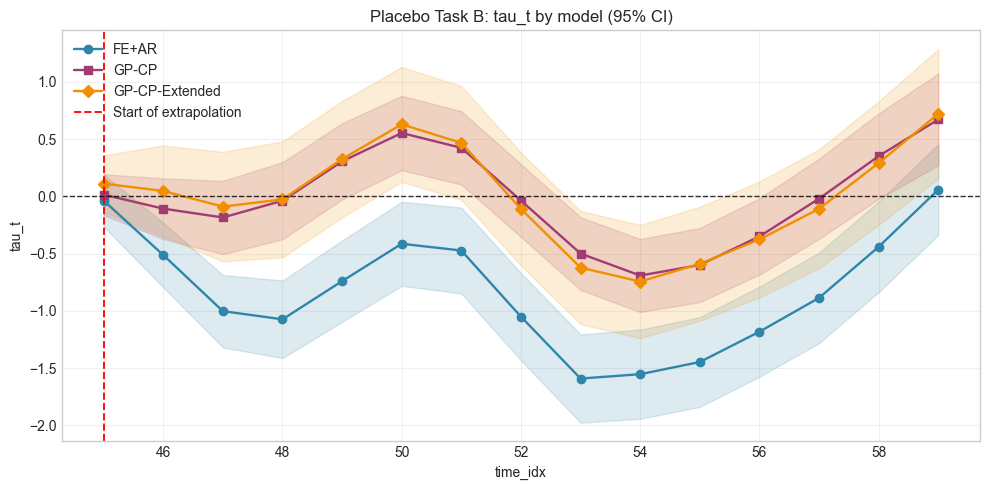

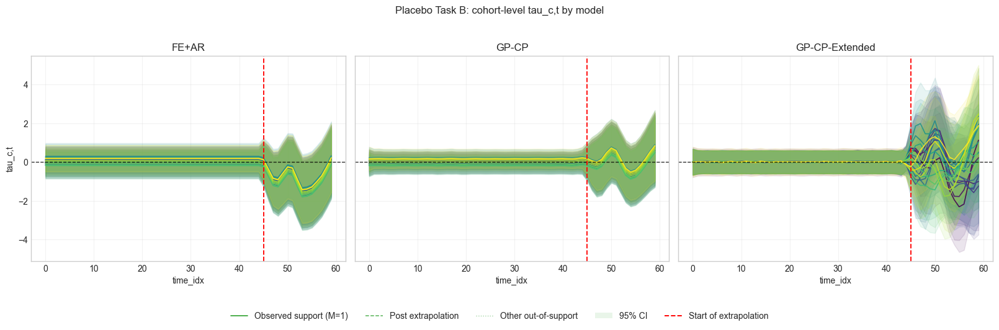

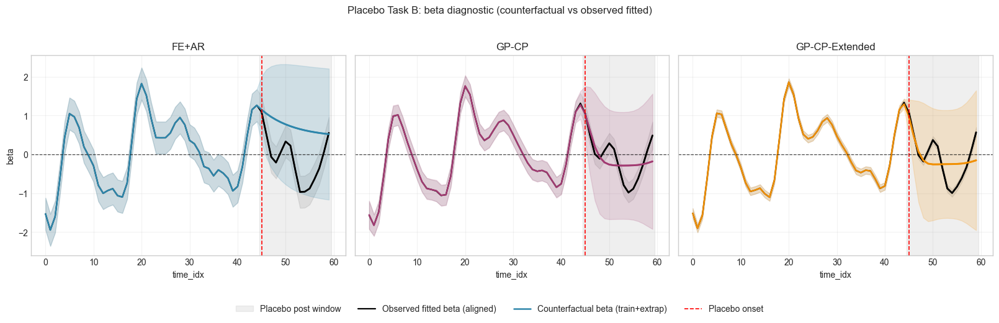

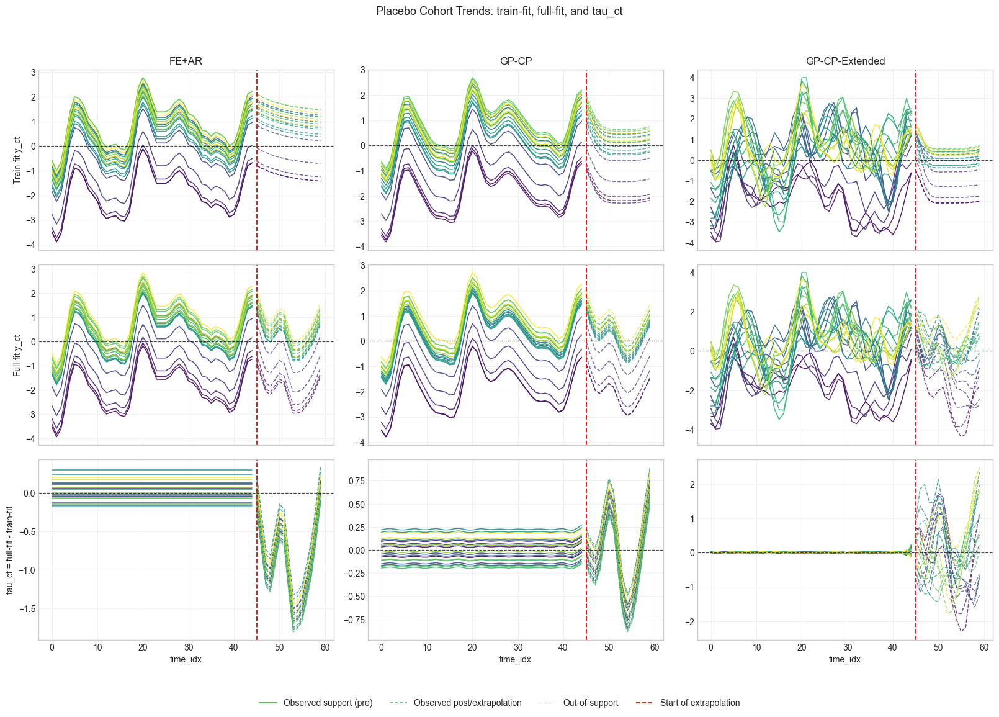

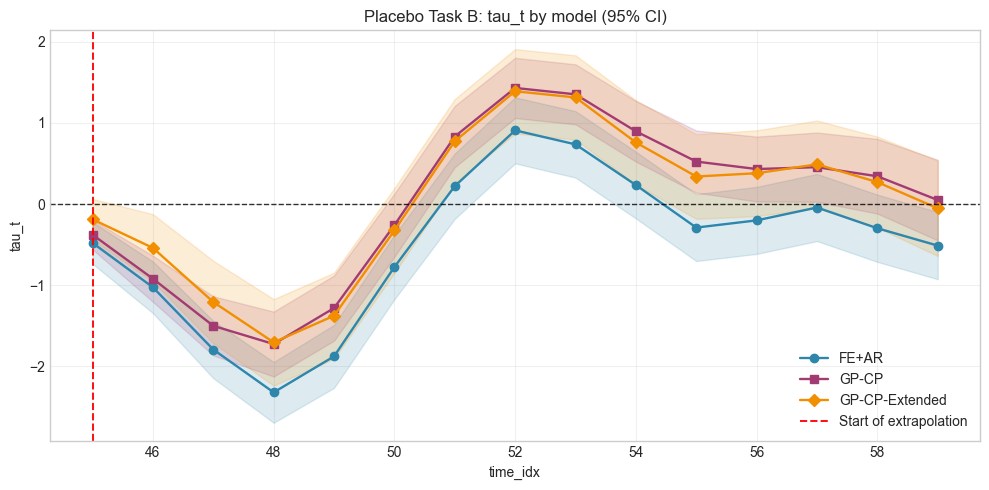

...

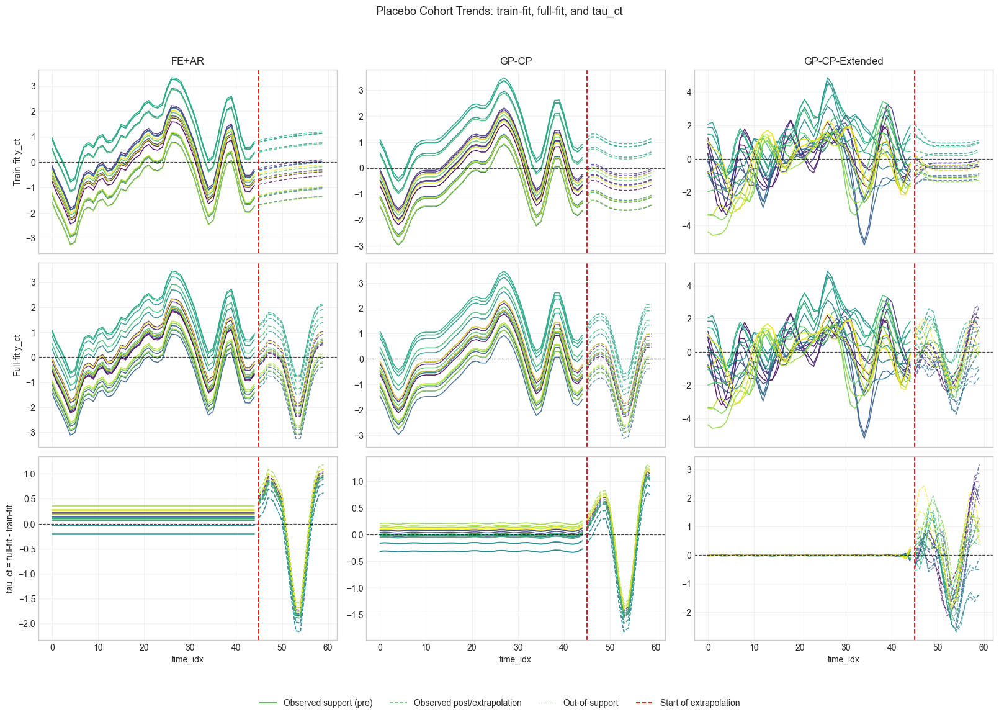

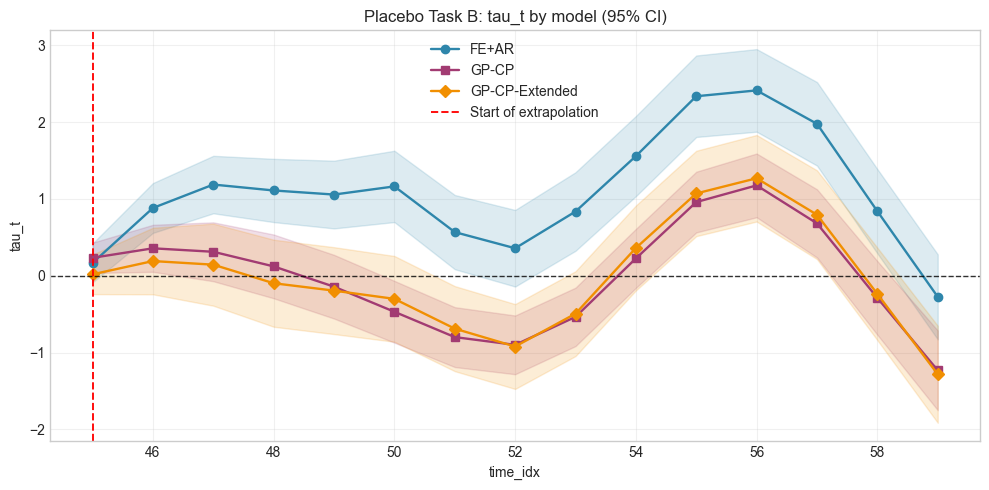

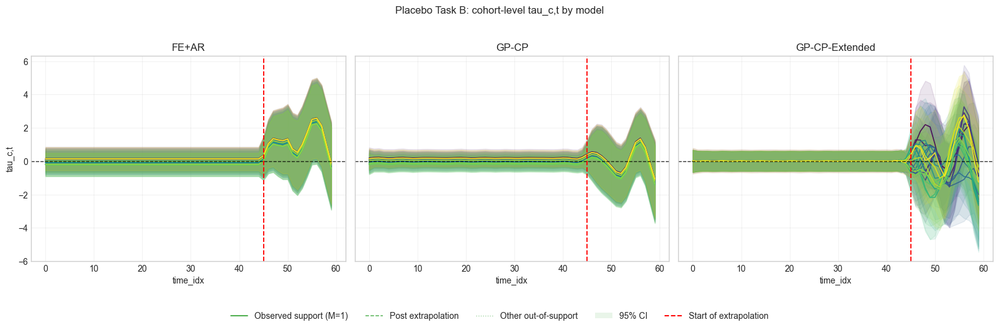

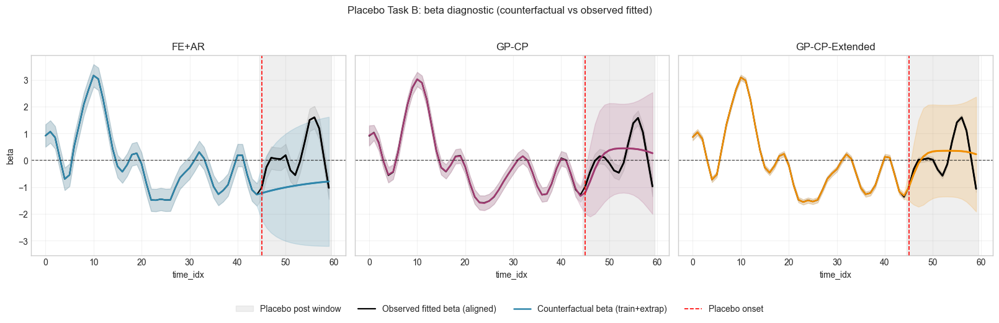

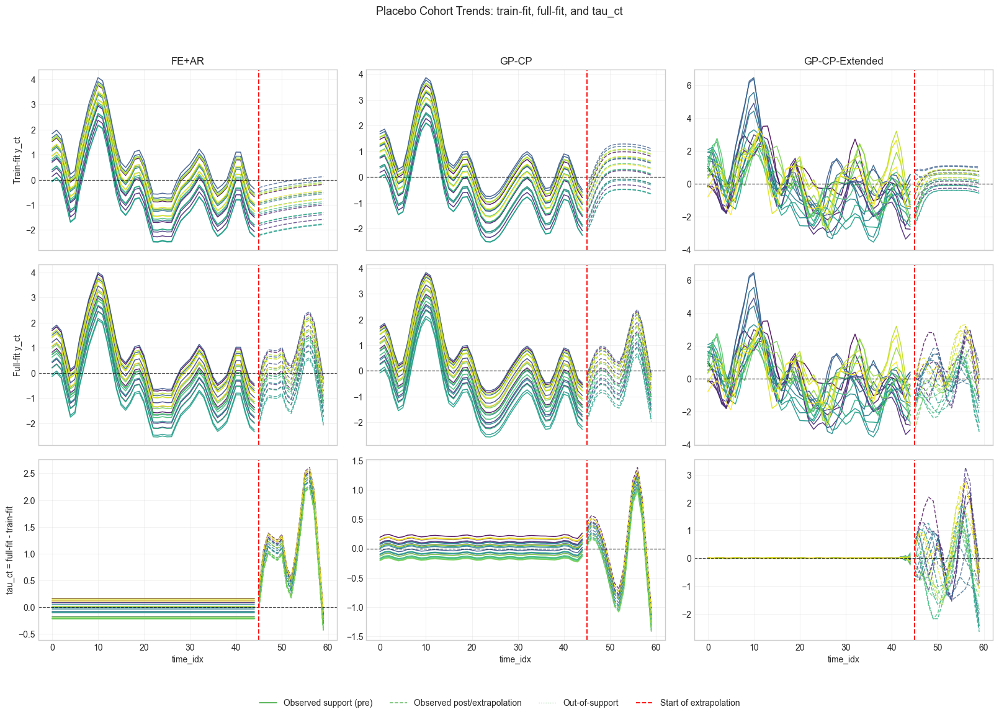

In [9]:
from src.visualization import plot_extrapolation

scenB_extrap_records = []
scenB_extrap_metric_records = []
scenB_extrap_y_records = []
scenB_extrap_y_metric_records = []
scenB_placebo_metric_records = []

for seed in SEEDS:
 data = simulate_cohort_data(
  n_cohorts=N_COHORTS,
  n_periods=N_PERIODS,
  n_reps=N_REPS,
  ell_c=ELL_C, sf_c=SF_C,
  ell_t=ELL_T, sf_t=SF_T,
  ell_gc=ELL_GC, sf_gc=SF_GC,
  ell_gt=ELL_GT, sf_gt=SF_GT,
  sn=SN,
  interaction=True,
  seed=seed,
 )

 seed_dir = _scenario_seed_dir('B', seed)
 obs_t = _to_numpy(data['obs_t']).astype(int)
 obs_c = _to_numpy(data['obs_c']).astype(int)
 y_all = _to_numpy(data['y']).astype(float)
 train_mask = obs_t <= TRAIN_CUTOFF
 test_mask = ~train_mask

 y_tr = y_all[train_mask]
 c_tr = obs_c[train_mask]
 t_tr = obs_t[train_mask]

 y_test = y_all[test_mask]
 c_test = obs_c[test_mask]
 t_test = obs_t[test_mask]

 t_train = TRAIN_CUTOFF + 1
 test_periods = np.arange(t_train, N_PERIODS, dtype=int)
 n_extrap = len(test_periods)
 beta_true_full = _to_numpy(data['beta_true'])
 beta_true_test = beta_true_full[test_periods]

 hp = data['hyperparams']

 fe = FixedEffectsModel(use_global_mean=False).fit(
  y=y_tr,
  obs_c=c_tr,
  obs_t=t_tr,
  n_cohorts=N_COHORTS,
  n_periods=t_train,
  seed=seed,
  true_hyperparams=hp,
 )
 fe_mean, fe_std = fe.extrapolate(n_extrap)

 cp = CohortPeriodModel(use_global_mean=False).fit(
  y=y_tr,
  obs_c=c_tr,
  obs_t=t_tr,
  n_cohorts=N_COHORTS,
  n_periods=N_PERIODS,
  seed=seed,
  true_hyperparams=hp,
 ).results_dict

 ext = CohortPeriodExtendedModel(use_global_mean=False).fit(
  y=y_tr,
  obs_c=c_tr,
  obs_t=t_tr,
  n_cohorts=N_COHORTS,
  n_periods=N_PERIODS,
  seed=seed,
  true_hyperparams=hp,
 ).results_dict

 model_preds = {
  'FE+AR': {'mean': np.asarray(fe_mean, dtype=float), 'std': np.asarray(fe_std, dtype=float)},
  'GP-CP': {'mean': np.asarray(cp['beta'], dtype=float)[test_periods], 'std': np.asarray(cp['std_beta'], dtype=float)[test_periods]},
  'GP-CP-Extended': {'mean': np.asarray(ext['beta'], dtype=float)[test_periods], 'std': np.asarray(ext['std_beta'], dtype=float)[test_periods]},
 }

 seed_rows = []
 seed_metrics = []
 for model_label, pred in model_preds.items:
  mean = pred['mean']
  std = pred['std']
  lo95 = mean - 1.96 * std
  hi95 = mean + 1.96 * std

  for k, t in enumerate(test_periods):
   seed_rows.append({'model': model_label, 'period': int(t), 'mean': float(mean[k]), 'lo95': float(lo95[k]), 'hi95': float(hi95[k]), 'truth': float(beta_true_test[k])})

  m = summarise_extrapolation(pred_mean=mean, truth=beta_true_test)
  m['Coverage'] = float(np.mean((lo95 <= beta_true_test) & (beta_true_test <= hi95)))
  m['CI_Width'] = float(np.mean(hi95 - lo95))
  for metric_name, value in m.items:
   seed_metrics.append({'model': model_label, 'metric': metric_name, 'value': float(value)})

 y_pred = {
  'FE+AR': fe.mu_ + fe.alpha_[c_test] + np.asarray(fe_mean, dtype=float)[t_test - t_train],
  'GP-CP': float(cp.get('mu', 0.0)) + np.asarray(cp['alpha'])[c_test] + np.asarray(cp['beta'])[t_test] + np.asarray(cp['gamma'])[c_test, t_test],
  'GP-CP-Extended': float(ext.get('mu', 0.0)) + np.asarray(ext['alpha'])[c_test] + np.asarray(ext['beta'])[t_test] + np.asarray(ext['gamma'])[c_test, t_test],
 }

 y_rows = []
 y_metrics = []
 for model_label, yh in y_pred.items:
  resid = yh - y_test
  for i in range(len(y_test)):
   y_rows.append({'model': model_label, 'cohort': int(c_test[i]), 'period': int(t_test[i]), 'y_true': float(y_test[i]), 'y_hat': float(yh[i]), 'resid': float(resid[i])})
  y_metrics.extend([
   {'model': model_label, 'metric': 'Bias', 'value': float(np.mean(resid))},
   {'model': model_label, 'metric': 'MAE', 'value': float(np.mean(np.abs(resid)))},
   {'model': model_label, 'metric': 'RMSE', 'value': float(np.sqrt(np.mean(resid ** 2)))},
  ])

 seed_extrap_df = pd.DataFrame(seed_rows)
 seed_extrap_metrics_df = pd.DataFrame(seed_metrics)
 seed_y_df = pd.DataFrame(y_rows)
 seed_y_metrics_df = pd.DataFrame(y_metrics)

 seed_extrap_df.to_csv(seed_dir / f'scenB_extrap_seed{seed}.csv', index=False)
 seed_extrap_metrics_df.to_csv(seed_dir / f'scenB_extrap_metrics_seed{seed}.csv', index=False)
 (seed_dir / f'scenB_extrap_metrics_seed{seed}.txt').write_text(seed_extrap_metrics_df.to_string(index=False) + "\n")

 seed_y_df.to_csv(seed_dir / f'scenB_extrap_y_seed{seed}.csv', index=False)
 seed_y_metrics_df.to_csv(seed_dir / f'scenB_extrap_y_metrics_seed{seed}.csv', index=False)
 (seed_dir / f'scenB_extrap_y_metrics_seed{seed}.txt').write_text(seed_y_metrics_df.to_string(index=False) + "\n")

 scenB_extrap_records.append(seed_extrap_df.assign(seed=seed))
 scenB_extrap_metric_records.append(seed_extrap_metrics_df.assign(seed=seed))
 scenB_extrap_y_records.append(seed_y_df.assign(seed=seed))
 scenB_extrap_y_metric_records.append(seed_y_metrics_df.assign(seed=seed))

 
 # Placebo TE on extrapolation window (truth is 0)
 model_order = ['FE+AR', 'GP-CP', 'GP-CP-Extended']
 support_mask_sim = np.ones((N_COHORTS, N_PERIODS), dtype=bool)

 fe_train_beta = np.concatenate([np.asarray(fe.beta_, dtype=float), np.asarray(fe_mean, dtype=float)])
 fe_train_beta_std = np.concatenate([np.asarray(fe.std_beta_, dtype=float), np.asarray(fe_std, dtype=float)])
 train_fit = {
  'FE+AR': {
   'mu': float(fe.mu_),
   'alpha': np.asarray(fe.alpha_, dtype=float),
   'beta': fe_train_beta,
   'std_alpha': np.asarray(fe.std_alpha_, dtype=float),
   'std_beta': fe_train_beta_std,
   'gamma': np.zeros((N_COHORTS, N_PERIODS), dtype=float),
   'std_gamma': np.zeros((N_COHORTS, N_PERIODS), dtype=float),
  },
  'GP-CP': {
   'mu': float(cp.get('mu', 0.0)),
   'alpha': np.asarray(cp['alpha'], dtype=float),
   'beta': np.asarray(cp['beta'], dtype=float),
   'std_alpha': np.asarray(cp.get('std_alpha', np.zeros(N_COHORTS)), dtype=float),
   'std_beta': np.asarray(cp.get('std_beta', np.zeros(N_PERIODS)), dtype=float),
   'gamma': np.asarray(cp.get('gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
   'std_gamma': np.asarray(cp.get('std_gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
  },
  'GP-CP-Extended': {
   'mu': float(ext.get('mu', 0.0)),
   'alpha': np.asarray(ext['alpha'], dtype=float),
   'beta': np.asarray(ext['beta'], dtype=float),
   'std_alpha': np.asarray(ext.get('std_alpha', np.zeros(N_COHORTS)), dtype=float),
   'std_beta': np.asarray(ext.get('std_beta', np.zeros(N_PERIODS)), dtype=float),
   'gamma': np.asarray(ext.get('gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
   'std_gamma': np.asarray(ext.get('std_gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
  },
 }

 fe_full = FixedEffectsModel(use_global_mean=False).fit(
  y=y_all,
  obs_c=obs_c,
  obs_t=obs_t,
  n_cohorts=N_COHORTS,
  n_periods=N_PERIODS,
  seed=seed,
  true_hyperparams=hp,
 )
 cp_full = CohortPeriodModel(use_global_mean=False).fit(
  y=y_all,
  obs_c=obs_c,
  obs_t=obs_t,
  n_cohorts=N_COHORTS,
  n_periods=N_PERIODS,
  seed=seed,
  true_hyperparams=hp,
 ).results_dict
 ext_full = CohortPeriodExtendedModel(use_global_mean=False).fit(
  y=y_all,
  obs_c=obs_c,
  obs_t=obs_t,
  n_cohorts=N_COHORTS,
  n_periods=N_PERIODS,
  seed=seed,
  true_hyperparams=hp,
 ).results_dict

 full_fit = {
  'FE+AR': {
   'mu': float(fe_full.mu_),
   'alpha': np.asarray(fe_full.alpha_, dtype=float),
   'beta': np.asarray(fe_full.beta_, dtype=float),
   'std_alpha': np.asarray(fe_full.std_alpha_, dtype=float),
   'std_beta': np.asarray(fe_full.std_beta_, dtype=float),
   'gamma': np.zeros((N_COHORTS, N_PERIODS), dtype=float),
   'std_gamma': np.zeros((N_COHORTS, N_PERIODS), dtype=float),
  },
  'GP-CP': {
   'mu': float(cp_full.get('mu', 0.0)),
   'alpha': np.asarray(cp_full['alpha'], dtype=float),
   'beta': np.asarray(cp_full['beta'], dtype=float),
   'std_alpha': np.asarray(cp_full.get('std_alpha', np.zeros(N_COHORTS)), dtype=float),
   'std_beta': np.asarray(cp_full.get('std_beta', np.zeros(N_PERIODS)), dtype=float),
   'gamma': np.asarray(cp_full.get('gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
   'std_gamma': np.asarray(cp_full.get('std_gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
  },
  'GP-CP-Extended': {
   'mu': float(ext_full.get('mu', 0.0)),
   'alpha': np.asarray(ext_full['alpha'], dtype=float),
   'beta': np.asarray(ext_full['beta'], dtype=float),
   'std_alpha': np.asarray(ext_full.get('std_alpha', np.zeros(N_COHORTS)), dtype=float),
   'std_beta': np.asarray(ext_full.get('std_beta', np.zeros(N_PERIODS)), dtype=float),
   'gamma': np.asarray(ext_full.get('gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
   'std_gamma': np.asarray(ext_full.get('std_gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
  },
 }

 tau_t_df, tau_ct_df, _ = compute_beta_placebo_te_tables(
  category=f'scenB_seed{seed}',
  train_fit=train_fit,
  full_fit=full_fit,
  n_t_tr=t_train,
  n_t=N_PERIODS,
  n_c=N_COHORTS,
  support_mask=support_mask_sim,
  model_order=model_order,
 )
 te_summary_df = summarise_placebo_estimands(
  category=f'scenB_seed{seed}',
  tau_ct_df=tau_ct_df,
  tau_t_df=tau_t_df,
  model_order=model_order,
 )
 placebo_long_df = te_summary_df.melt(
  id_vars=['category', 'model'], var_name='metric', value_name='value'
 )

 tau_t_df.to_csv(seed_dir / f'scenB_placebo_tau_t_seed{seed}.csv', index=False)
 tau_ct_df.to_csv(seed_dir / f'scenB_placebo_tau_ct_seed{seed}.csv', index=False)
 te_summary_df.to_csv(seed_dir / f'scenB_placebo_summary_seed{seed}.csv', index=False)
 placebo_long_df.to_csv(seed_dir / f'scenB_placebo_metrics_long_seed{seed}.csv', index=False)
 if 'placebo_long_df' not in locals:
  placebo_long_df = pd.DataFrame(columns=['category', 'model', 'metric', 'value'])
 scenB_placebo_metric_records.append(placebo_long_df.assign(seed=seed))

 plot_placebo_tau_t_by_model_lines_ci(
  tau_t_df=tau_t_df,
  model_order=model_order,
  treatment_time_idx=t_train,
  treatment_label='Start of extrapolation',
  save_path=str(seed_dir / f'scenB_seed{seed}_placebo_tau_t.pdf'),
 )
 plot_placebo_tau_ct_extended_lines_ci(
  tau_ct_df=tau_ct_df,
  model_order=model_order,
  treatment_time_idx=t_train,
  treatment_label='Start of extrapolation',
  save_path=str(seed_dir / f'scenB_seed{seed}_placebo_tau_ct.pdf'),
 )
 plot_placebo_beta_diagnostic_3panel(
  train_fit=train_fit,
  full_fit=full_fit,
  n_t_tr=t_train,
  n_t=N_PERIODS,
  model_order=model_order,
  save_path=str(seed_dir / f'scenB_seed{seed}_placebo_beta_diag.pdf'),
 )
 plot_placebo_cohort_trends_3x3(
  train_fit=train_fit,
  full_fit=full_fit,
  support_mask=support_mask_sim,
  model_order=model_order,
  treatment_time_idx=t_train,
  treatment_label='Start of extrapolation',
  extrapolation_start_idx=t_train,
  save_path=str(seed_dir / f'scenB_seed{seed}_placebo_cohort_trends_3x3.pdf'),
 )

 print(f'[B-2] seed={seed}: extrapolation artifacts written to {seed_dir}')

scenB_extrap_all = pd.concat(scenB_extrap_records, ignore_index=True)
scenB_extrap_metrics_all = pd.concat(scenB_extrap_metric_records, ignore_index=True)
scenB_extrap_y_all = pd.concat(scenB_extrap_y_records, ignore_index=True)
scenB_extrap_y_metrics_all = pd.concat(scenB_extrap_y_metric_records, ignore_index=True)
scenB_placebo_metrics_all = pd.concat(scenB_placebo_metric_records, ignore_index=True)

summary_scenB_placebo = (
 scenB_placebo_metrics_all
.groupby(['model', 'metric'], as_index=False)['value']
.agg(mean='mean', std='std')
)
summary_scenB_placebo.to_csv(SIM_ROOT / 'summary_scenB_placebo.csv', index=False)

print("\nB-2 complete.")
print('Rows in scenB_extrap_all:', len(scenB_extrap_all))
print('Rows in scenB_extrap_y_all:', len(scenB_extrap_y_all))
display(scenB_extrap_metrics_all.head(12))


### B-3 Aggregate Metrics
- Step: Aggregate Scenario B metrics across seeds.
- Save: Scenario B summary tables for fitting, extrapolation, and placebo outputs.


In [10]:
summary_scenB_extrap = (
 scenB_extrap_metrics_all
.groupby(['model', 'metric'], as_index=False)['value']
.agg(mean='mean', std='std')
)
summary_scenB_extrap.to_csv(SIM_ROOT / 'summary_scenB_extrap.csv', index=False)

summary_scenB_extrap_wide = summary_scenB_extrap.pivot_table(
 index='model', columns='metric', values='mean', aggfunc='first',
).reset_index
summary_scenB_extrap_wide.to_csv(SIM_ROOT / 'summary_scenB_extrap_wide.csv', index=False)

summary_scenB_extrap_y = (
 scenB_extrap_y_metrics_all
.groupby(['model', 'metric'], as_index=False)['value']
.agg(mean='mean', std='std')
)
summary_scenB_extrap_y.to_csv(SIM_ROOT / 'summary_scenB_extrap_y.csv', index=False)

print('B-3 complete.')
print('Wrote:', SIM_ROOT / 'summary_scenB_extrap.csv')
print('Wrote:', SIM_ROOT / 'summary_scenB_extrap_y.csv')

print("\nScenario B fit summary (from B-1):")
display(summary_scenB_fit.head(24))

print("\nScenario B beta-extrap summary (B-2 aggregated):")
display(summary_scenB_extrap)

print("\nScenario B held-out y extrap summary:")
display(summary_scenB_extrap_y)


B-3 complete.
Wrote:../results/simulations/summary_scenB_extrap.csv
Wrote:../results/simulations/summary_scenB_extrap_y.csv

Scenario B fit summary (from B-1):


,model,effect_type,metric,mean,std
0,FE+AR,alpha,Bias,-5.273559e-18,1.046941e-16
1,FE+AR,alpha,CI_Width,4.678735e-01,1.849595e-02
2,FE+AR,alpha,Coverage,1.000000e+00,0.000000e+00
3,FE+AR,alpha,RMSE,3.246572e-02,4.944799e-03
4,FE+AR,beta,Bias,-8.465451e-18,4.083401e-17
5,FE+AR,beta,CI_Width,8.244753e-01,3.259311e-02
6,FE+AR,beta,Coverage,1.000000e+00,0.000000e+00
7,FE+AR,beta,RMSE,6.434038e-02,3.869010e-03
8,FE+AR,gamma,Bias,7.031412e-18,1.625802e-17
9,FE+AR,gamma,CI_Width,NaN,NaN



Scenario B beta-extrap summary (B-2 aggregated):


,model,metric,mean,std
0,FE+AR,CI_Width,3.273766,0.484012
1,FE+AR,Coverage,0.893333,0.121106
2,FE+AR,MAE,0.876660,0.145772
3,FE+AR,MAPE,731.492164,738.797856
4,FE+AR,RMSE,1.051208,0.152512
5,GP-CP,CI_Width,2.919914,0.458461
6,GP-CP,Coverage,0.960000,0.059628
7,GP-CP,MAE,0.578988,0.181308
8,GP-CP,MAPE,246.625900,108.051256
9,GP-CP,RMSE,0.683274,0.226748



Scenario B held-out y extrap summary:


,model,metric,mean,std
0,FE+AR,Bias,-0.119837,0.823789
1,FE+AR,MAE,1.153526,0.078831
2,FE+AR,RMSE,1.427761,0.120993
3,GP-CP,Bias,-0.014384,0.036065
4,GP-CP,MAE,0.976738,0.148347
5,GP-CP,RMSE,1.188638,0.164834
6,GP-CP-Extended,Bias,-0.014570,0.034398
7,GP-CP-Extended,MAE,0.940394,0.131384
8,GP-CP-Extended,RMSE,1.154763,0.157206


### B-4 Plots
- Step: Plot Scenario B recovery and extrapolation diagnostics.
- Save: Scenario B figures for model comparison.


Figure saved ->../results/simulations/B/0/scenB_seed0_effect_recovery.pdf
Figure saved ->../results/simulations/B/0/scenB_seed0_effect_recovery_residuals.pdf
Figure saved ->../results/simulations/B/0/scenB_seed0_effect_recovery_cohort_trends.pdf
Figure saved ->../results/simulations/B/0/scenB_seed0_extrapolation_beta.pdf
Figure saved ->../results/simulations/B/0/scenB_seed0_extrapolation_y.pdf


/path/to/your/project UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
 fig.tight_layout(rect=[0, 0, 1, 0.96])


Figure saved ->../results/simulations/B/0/scenB_seed0_interaction_heatmap.pdf
[B-4] seed=0: effect/beta-extrap/y-extrap/interaction plots + metrics table written
Figure saved ->../results/simulations/B/1/scenB_seed1_effect_recovery.pdf
Figure saved ->../results/simulations/B/1/scenB_seed1_effect_recovery_residuals.pdf
Figure saved ->../results/simulations/B/1/scenB_seed1_effect_recovery_cohort_trends.pdf
Figure saved ->../results/simulations/B/1/scenB_seed1_extrapolation_beta.pdf
Figure saved ->../results/simulations/B/1/scenB_seed1_extrapolation_y.pdf


/path/to/your/project UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
 fig.tight_layout(rect=[0, 0, 1, 0.96])


Figure saved ->../results/simulations/B/1/scenB_seed1_interaction_heatmap.pdf
[B-4] seed=1: effect/beta-extrap/y-extrap/interaction plots + metrics table written
Figure saved ->../results/simulations/B/2/scenB_seed2_effect_recovery.pdf
Figure saved ->../results/simulations/B/2/scenB_seed2_effect_recovery_residuals.pdf
Figure saved ->../results/simulations/B/2/scenB_seed2_effect_recovery_cohort_trends.pdf
Figure saved ->../results/simulations/B/2/scenB_seed2_extrapolation_beta.pdf
Figure saved ->../results/simulations/B/2/scenB_seed2_extrapolation_y.pdf


/path/to/your/project UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
 fig.tight_layout(rect=[0, 0, 1, 0.96])


Figure saved ->../results/simulations/B/2/scenB_seed2_interaction_heatmap.pdf
[B-4] seed=2: effect/beta-extrap/y-extrap/interaction plots + metrics table written
Figure saved ->../results/simulations/B/3/scenB_seed3_effect_recovery.pdf
Figure saved ->../results/simulations/B/3/scenB_seed3_effect_recovery_residuals.pdf
Figure saved ->../results/simulations/B/3/scenB_seed3_effect_recovery_cohort_trends.pdf


/path/to/your/project RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close`.
 fig, axes = plt.subplots(1, 3, figsize=(15, 4.8), sharey=True)


Figure saved ->../results/simulations/B/3/scenB_seed3_extrapolation_beta.pdf
Figure saved ->../results/simulations/B/3/scenB_seed3_extrapolation_y.pdf


/path/to/your/project UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
 fig.tight_layout(rect=[0, 0, 1, 0.96])


Figure saved ->../results/simulations/B/3/scenB_seed3_interaction_heatmap.pdf
[B-4] seed=3: effect/beta-extrap/y-extrap/interaction plots + metrics table written
Figure saved ->../results/simulations/B/4/scenB_seed4_effect_recovery.pdf
Figure saved ->../results/simulations/B/4/scenB_seed4_effect_recovery_residuals.pdf
Figure saved ->../results/simulations/B/4/scenB_seed4_effect_recovery_cohort_trends.pdf
Figure saved ->../results/simulations/B/4/scenB_seed4_extrapolation_beta.pdf
Figure saved ->../results/simulations/B/4/scenB_seed4_extrapolation_y.pdf
Figure saved ->../results/simulations/B/4/scenB_seed4_interaction_heatmap.pdf
[B-4] seed=4: effect/beta-extrap/y-extrap/interaction plots + metrics table written

B-4 complete.
Per-seed plots and model metric tables written under:../results/simulations/B


/path/to/your/project UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
 fig.tight_layout(rect=[0, 0, 1, 0.96])


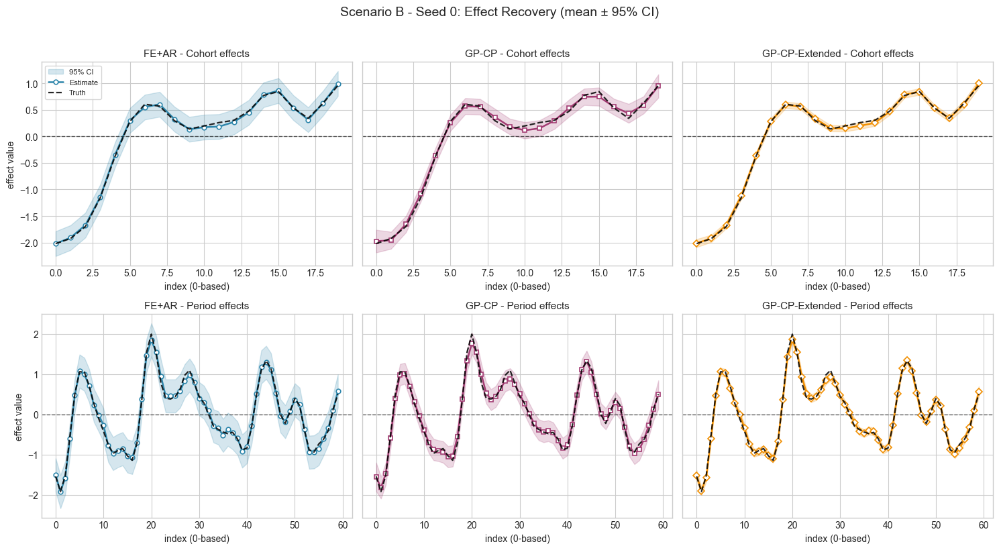

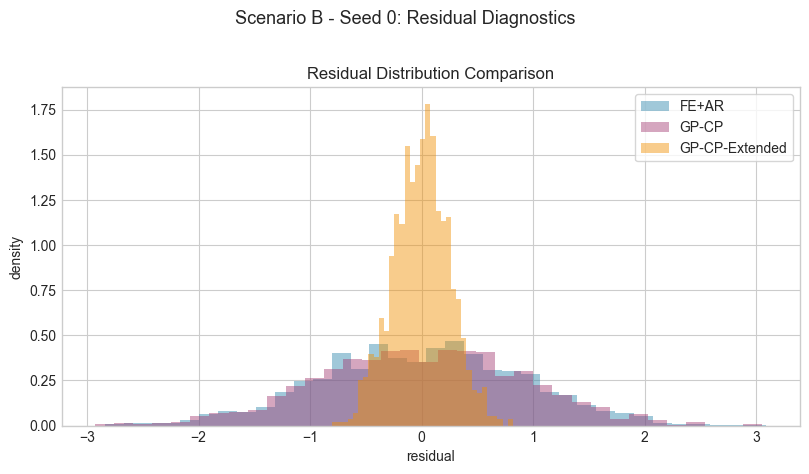

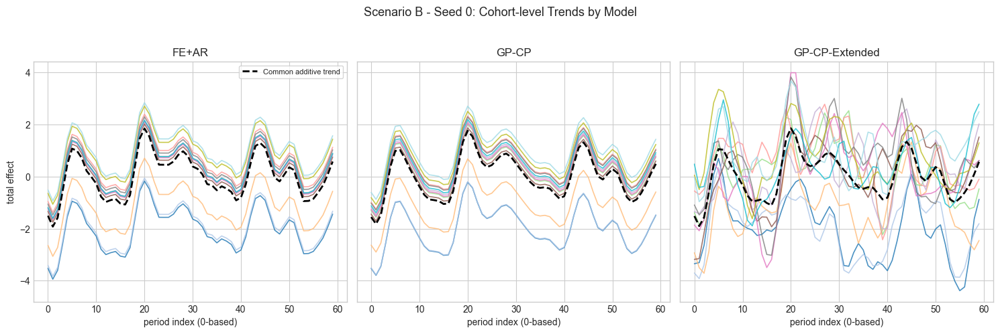

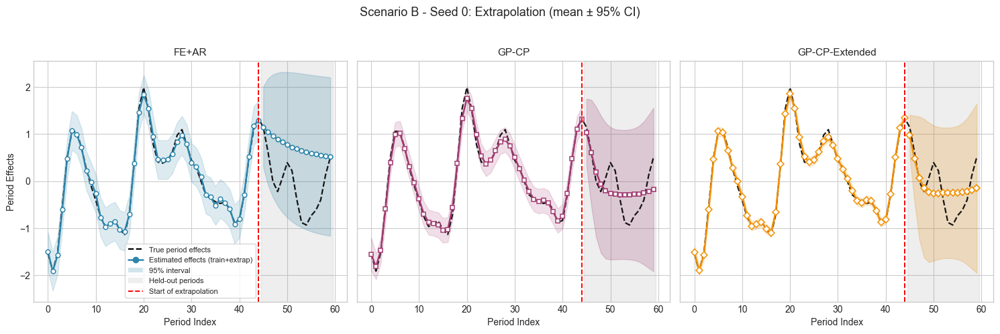

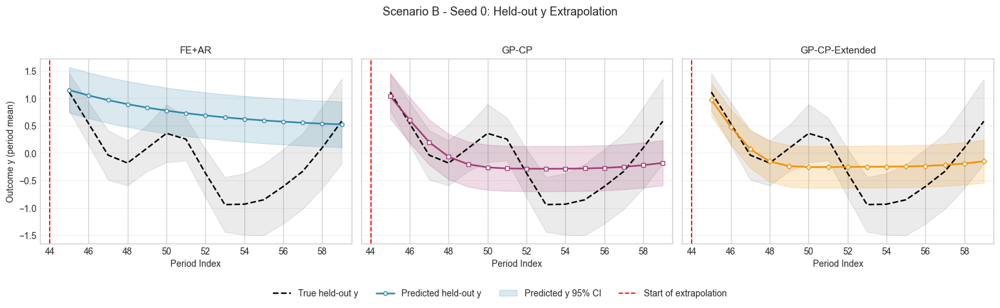

...

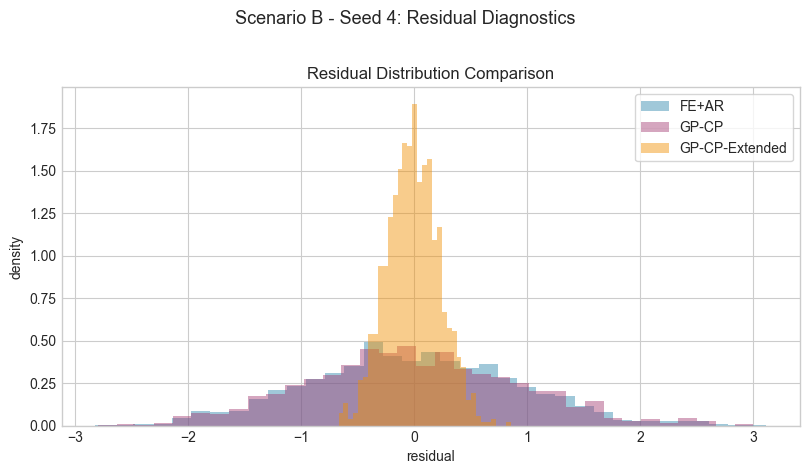

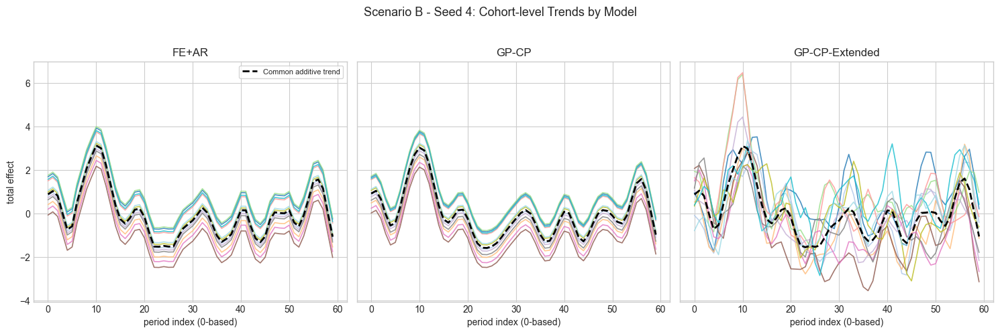

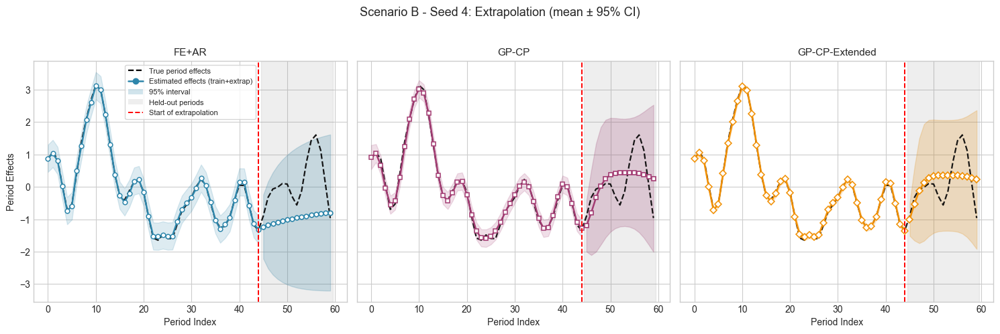

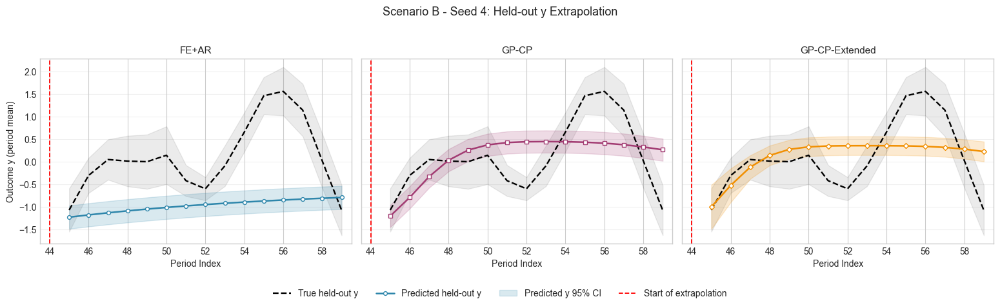

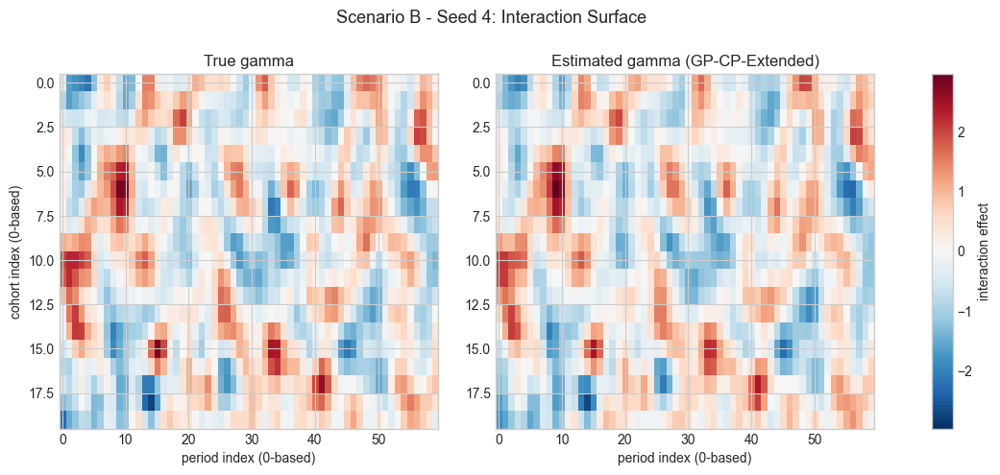

In [11]:
from src.visualization import plot_extrapolation, plot_extrapolation_y, plot_interaction_heatmap

for seed in SEEDS:
 seed_dir = _scenario_seed_dir('B', seed)

 fit_csv = seed_dir / f'scenB_fit_seed{seed}.csv'
 extrap_csv = seed_dir / f'scenB_extrap_seed{seed}.csv'
 y_extrap_csv = seed_dir / f'scenB_extrap_y_seed{seed}.csv'

 if not fit_csv.exists or not extrap_csv.exists or not y_extrap_csv.exists:
  print(f'[B-4] seed={seed}: missing fit/extrap CSV; skip plotting')
  continue

 fit_df = pd.read_csv(fit_csv)
 extrap_df = pd.read_csv(extrap_csv)
 y_extrap_df = pd.read_csv(y_extrap_csv)

 data = simulate_cohort_data(
  n_cohorts=N_COHORTS, n_periods=N_PERIODS, n_reps=N_REPS,
  ell_c=ELL_C, sf_c=SF_C, ell_t=ELL_T, sf_t=SF_T,
  ell_gc=ELL_GC, sf_gc=SF_GC, ell_gt=ELL_GT, sf_gt=SF_GT,
  sn=SN, interaction=True, seed=seed,
 )

 fitted_full = _fit_models_full_data(data, use_global_mean=False)
 fit_info = _fit_info_for_plots(data, fitted_full)

 beta_true_full = _to_numpy(data['beta_true'])

 plot_effect_recovery(fit_df, scenario='B', seed=seed, fit_info=fit_info,
       save_path=str(seed_dir / f'scenB_seed{seed}_effect_recovery.pdf'))

 plot_extrapolation(
  fit_df=fit_df,
  extrap_df=extrap_df,
  beta_true_full=beta_true_full,
  train_cutoff=TRAIN_CUTOFF,
  scenario='B',
  seed=seed,
  save_path=str(seed_dir / f'scenB_seed{seed}_extrapolation_beta.pdf'),
 )

 plot_extrapolation_y(
  extrap_y_df=y_extrap_df,
  train_cutoff=TRAIN_CUTOFF,
  scenario='B',
  seed=seed,
  save_path=str(seed_dir / f'scenB_seed{seed}_extrapolation_y.pdf'),
 )

 plot_interaction_heatmap(
  gamma_true=_to_numpy(data['gamma_true']),
  gamma_hat=np.asarray(fitted_full['GP-CP-Extended']['gamma']),
  scenario='B',
  seed=seed,
  save_path=str(seed_dir / f'scenB_seed{seed}_interaction_heatmap.pdf'),
 )

 seed_fit_metrics = pd.read_csv(seed_dir / f'scenB_fit_metrics_seed{seed}.csv').assign(task='fit')
 seed_ex_metrics = pd.read_csv(seed_dir / f'scenB_extrap_metrics_seed{seed}.csv').assign(task='extrapolation', effect_type='beta')
 seed_ex_y_metrics = pd.read_csv(seed_dir / f'scenB_extrap_y_metrics_seed{seed}.csv').assign(task='extrapolation_y', effect_type='y')
 placebo_csv = seed_dir / f'scenB_placebo_metrics_long_seed{seed}.csv'
 if placebo_csv.exists:
  seed_placebo_metrics = pd.read_csv(placebo_csv)[['model', 'metric', 'value']].assign(task='placebo_te', effect_type='tau_att')
 else:
  seed_placebo_metrics = pd.DataFrame(columns=['model', 'metric', 'value', 'task', 'effect_type'])

 seed_model_table = pd.concat([seed_fit_metrics, seed_ex_metrics, seed_ex_y_metrics, seed_placebo_metrics], ignore_index=True)

 seed_model_table.to_csv(seed_dir / f'scenB_model_metrics_seed{seed}.csv', index=False)
 (seed_dir / f'scenB_model_metrics_seed{seed}.txt').write_text(seed_model_table.to_string(index=False) + "\n")

 print(f'[B-4] seed={seed}: effect/beta-extrap/y-extrap/interaction plots + metrics table written')

print("\nB-4 complete.")
print('Per-seed plots and model metric tables written under:', SIM_ROOT / 'B')


## Combined Summary
- Step: Merge scenario-level outputs into combined tables.
- Save: Cross-scenario summary datasets for reporting.


In [12]:
# Merge scenario-level summaries into one long table: scenario × task × model × effect_type × metric

if 'summary_scenA_fit' not in globals:
 summary_scenA_fit = pd.read_csv(SIM_ROOT / 'summary_scenA_fit.csv')
if 'summary_scenA_extrap' not in globals:
 summary_scenA_extrap = pd.read_csv(SIM_ROOT / 'summary_scenA_extrap.csv')
if 'summary_scenA_extrap_y' not in globals:
 summary_scenA_extrap_y = pd.read_csv(SIM_ROOT / 'summary_scenA_extrap_y.csv')
if 'summary_scenB_fit' not in globals:
 summary_scenB_fit = pd.read_csv(SIM_ROOT / 'summary_scenB_fit.csv')
if 'summary_scenB_extrap' not in globals:
 summary_scenB_extrap = pd.read_csv(SIM_ROOT / 'summary_scenB_extrap.csv')
if 'summary_scenB_extrap_y' not in globals:
 summary_scenB_extrap_y = pd.read_csv(SIM_ROOT / 'summary_scenB_extrap_y.csv')
if 'summary_scenA_placebo' not in globals:
 summary_scenA_placebo = pd.read_csv(SIM_ROOT / 'summary_scenA_placebo.csv')
if 'summary_scenB_placebo' not in globals:
 summary_scenB_placebo = pd.read_csv(SIM_ROOT / 'summary_scenB_placebo.csv')

summaries = []
summaries.append(summary_scenA_fit.assign(scenario='A', task='fit'))
summaries.append(summary_scenA_extrap.assign(scenario='A', task='extrapolation', effect_type='beta'))
summaries.append(summary_scenA_extrap_y.assign(scenario='A', task='extrapolation_y', effect_type='y'))
summaries.append(summary_scenB_fit.assign(scenario='B', task='fit'))
summaries.append(summary_scenB_extrap.assign(scenario='B', task='extrapolation', effect_type='beta'))
summaries.append(summary_scenB_extrap_y.assign(scenario='B', task='extrapolation_y', effect_type='y'))
summaries.append(summary_scenA_placebo.assign(scenario='A', task='placebo_te', effect_type='tau_att'))
summaries.append(summary_scenB_placebo.assign(scenario='B', task='placebo_te', effect_type='tau_att'))

summary_all_df = pd.concat(summaries, ignore_index=True)
summary_all_df = summary_all_df[['scenario', 'task', 'model', 'effect_type', 'metric', 'mean', 'std']].sort_values(['scenario', 'task', 'model', 'effect_type', 'metric']).reset_index(drop=True)

summary_all_path = SIM_ROOT / 'summary_ALL.csv'
summary_all_df.to_csv(summary_all_path, index=False)
summary_all_wide = summary_all_df.pivot_table(
 index=['scenario', 'task', 'model', 'effect_type'], columns='metric', values='mean', aggfunc='first',
).reset_index
summary_all_wide.to_csv(SIM_ROOT / 'summary_ALL_wide.csv', index=False)

print('Combined summary complete.')
print('Wrote:', summary_all_path)
print('Wrote:', SIM_ROOT / 'summary_ALL_wide.csv')
display(summary_all_df.head(30))


Combined summary complete.
Wrote:../results/simulations/summary_ALL.csv
Wrote:../results/simulations/summary_ALL_wide.csv


,scenario,task,model,effect_type,metric,mean,std
0,A,extrapolation,FE+AR,beta,CI_Width,3.328387e+00,3.988978e-01
1,A,extrapolation,FE+AR,beta,Coverage,8.800000e-01,8.692270e-02
2,A,extrapolation,FE+AR,beta,MAE,8.680507e-01,1.590175e-01
3,A,extrapolation,FE+AR,beta,MAPE,7.098552e+02,7.213922e+02
4,A,extrapolation,FE+AR,beta,RMSE,1.050242e+00,1.651328e-01
5,A,extrapolation,GP-CP,beta,CI_Width,2.908283e+00,3.285094e-01
6,A,extrapolation,GP-CP,beta,Coverage,9.733333e-01,5.962848e-02
7,A,extrapolation,GP-CP,beta,MAE,5.149955e-01,1.280510e-01
8,A,extrapolation,GP-CP,beta,MAPE,2.372518e+02,1.261763e+02
9,A,extrapolation,GP-CP,beta,RMSE,6.283488e-01,1.749629e-01


### Summary Plots
- Step: Create grouped comparison plots across scenarios and tasks.
- Output: Final figures used for high-level comparison.


Figure saved ->../results/simulations/summary_metrics_fit_barplot.pdf
Figure saved ->../results/simulations/summary_metrics_extrap_beta_barplot.pdf
Figure saved ->../results/simulations/summary_metrics_extrap_y_barplot.pdf
Summary plots complete.
Wrote:../results/simulations/summary_metrics_fit_barplot.pdf
Wrote:../results/simulations/summary_metrics_extrap_beta_barplot.pdf
Wrote:../results/simulations/summary_metrics_extrap_y_barplot.pdf
Wrote:../results/simulations/summary_coverage_table_fit.txt
Wrote:../results/simulations/summary_coverage_table_extrap_beta.txt
Figure saved ->../results/simulations/summary_metrics_placebo_tau_barplot.pdf
Figure saved ->../results/simulations/summary_metrics_placebo_att_barplot.pdf
Wrote:../results/simulations/summary_metrics_placebo_tau_barplot.pdf
Wrote:../results/simulations/summary_metrics_placebo_att_barplot.pdf
Wrote:../results/simulations/summary_placebo_table.csv
Wrote:../results/simulations/summary_placebo_table.txt


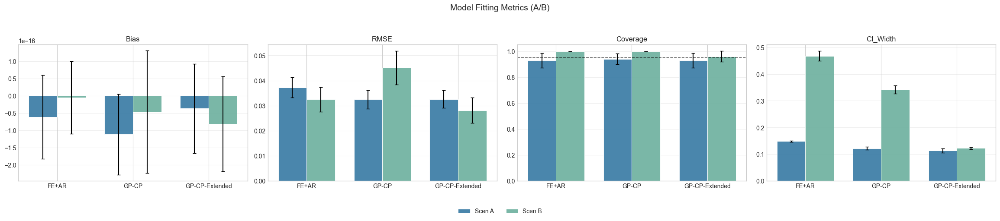

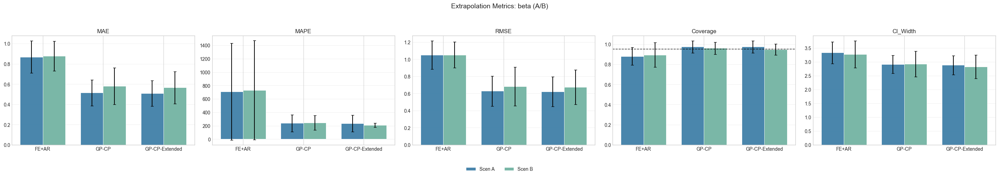

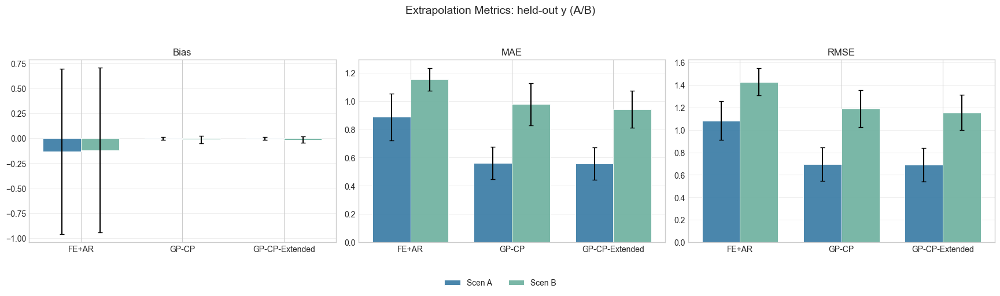

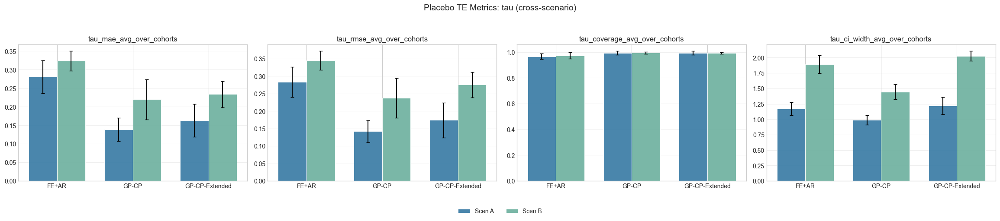

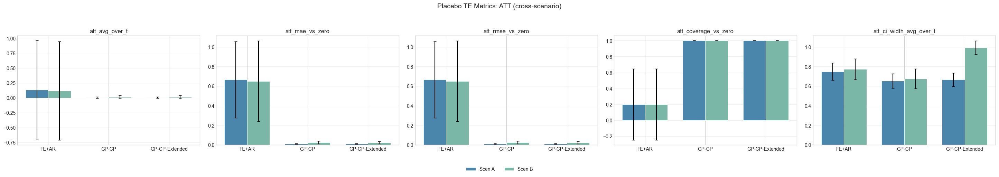

In [13]:
from src.visualization import plot_metric_summary

if 'summary_all_df' not in globals:
 summary_all_df = pd.read_csv(SIM_ROOT / 'summary_ALL.csv')

fit_df = summary_all_df[summary_all_df['task'].astype(str) == 'fit'].copy
ex_beta_df = summary_all_df[summary_all_df['task'].astype(str) == 'extrapolation'].copy
ex_y_df = summary_all_df[summary_all_df['task'].astype(str) == 'extrapolation_y'].copy

plot_metric_summary(fit_df, task='fit', metrics=['Bias', 'RMSE', 'Coverage', 'CI_Width'],
     title='Model Fitting Metrics (A/B)',
     save_path=str(SIM_ROOT / 'summary_metrics_fit_barplot.pdf'))

plot_metric_summary(ex_beta_df, task='extrapolation', metrics=['MAE', 'MAPE', 'RMSE', 'Coverage', 'CI_Width'],
     title='Extrapolation Metrics: beta (A/B)',
     save_path=str(SIM_ROOT / 'summary_metrics_extrap_beta_barplot.pdf'))

plot_metric_summary(ex_y_df, task='extrapolation_y', metrics=['Bias', 'MAE', 'RMSE'],
     title='Extrapolation Metrics: held-out y (A/B)',
     save_path=str(SIM_ROOT / 'summary_metrics_extrap_y_barplot.pdf'))

# Save coverage tables as TXT instead of PDF
cov_fit = fit_df[fit_df['metric'] == 'Coverage'].copy
cov_fit_tbl = cov_fit.pivot_table(index=['model', 'effect_type'], columns='scenario', values='mean', aggfunc='first').sort_index
(SIM_ROOT / 'summary_coverage_table_fit.txt').write_text(cov_fit_tbl.to_string + "\n")

cov_exb = ex_beta_df[ex_beta_df['metric'] == 'Coverage'].copy
cov_exb_tbl = cov_exb.pivot_table(index=['model', 'effect_type'], columns='scenario', values='mean', aggfunc='first').sort_index
(SIM_ROOT / 'summary_coverage_table_extrap_beta.txt').write_text(cov_exb_tbl.to_string + "\n")

print('Summary plots complete.')
print('Wrote:', SIM_ROOT / 'summary_metrics_fit_barplot.pdf')
print('Wrote:', SIM_ROOT / 'summary_metrics_extrap_beta_barplot.pdf')
print('Wrote:', SIM_ROOT / 'summary_metrics_extrap_y_barplot.pdf')
print('Wrote:', SIM_ROOT / 'summary_coverage_table_fit.txt')
print('Wrote:', SIM_ROOT / 'summary_coverage_table_extrap_beta.txt')

# Placebo-only cross-scenario summaries (tau/ATT)
placebo_df = summary_all_df[summary_all_df['task'].astype(str) == 'placebo_te'].copy
if not placebo_df.empty:
 tau_metrics = [
  'tau_mae_avg_over_cohorts',
  'tau_rmse_avg_over_cohorts',
  'tau_coverage_avg_over_cohorts',
  'tau_ci_width_avg_over_cohorts',
 ]
 att_metrics = [
  'att_avg_over_t',
  'att_mae_vs_zero',
  'att_rmse_vs_zero',
  'att_coverage_vs_zero',
  'att_ci_width_avg_over_t',
 ]

 tau_df = placebo_df[placebo_df['metric'].astype(str).isin(tau_metrics)].copy
 att_df = placebo_df[placebo_df['metric'].astype(str).isin(att_metrics)].copy

 if not tau_df.empty:
  plot_metric_summary(
   tau_df,
   task='placebo_te',
   metrics=tau_metrics,
   title='Placebo TE Metrics: tau (cross-scenario)',
   save_path=str(SIM_ROOT / 'summary_metrics_placebo_tau_barplot.pdf'),
  )

 if not att_df.empty:
  plot_metric_summary(
   att_df,
   task='placebo_te',
   metrics=att_metrics,
   title='Placebo TE Metrics: ATT (cross-scenario)',
   save_path=str(SIM_ROOT / 'summary_metrics_placebo_att_barplot.pdf'),
  )

 summary_placebo_table_ab = (
  placebo_df
 .pivot_table(index=['model', 'metric'], columns='scenario', values='mean', aggfunc='first')
 .sort_index
 )
 summary_placebo_table_ab.to_csv(SIM_ROOT / 'summary_placebo_table.csv')
 (SIM_ROOT / 'summary_placebo_table.txt').write_text(summary_placebo_table_ab.to_string + "\n")

 print('Wrote:', SIM_ROOT / 'summary_metrics_placebo_tau_barplot.pdf')
 print('Wrote:', SIM_ROOT / 'summary_metrics_placebo_att_barplot.pdf')
 print('Wrote:', SIM_ROOT / 'summary_placebo_table.csv')
 print('Wrote:', SIM_ROOT / 'summary_placebo_table.txt')


Figure saved ->../results/simulations/summary_metrics_fit_barplot.pdf
Figure saved ->../results/simulations/summary_metrics_extrap_barplot.pdf
Figure saved ->../results/simulations/summary_coverage_table_fit.pdf
Figure saved ->../results/simulations/summary_coverage_table_extrap.pdf
Summary plots complete.
Wrote:../results/simulations/summary_metrics_fit_barplot.pdf
Wrote:../results/simulations/summary_metrics_extrap_barplot.pdf
Wrote:../results/simulations/summary_coverage_table_fit.pdf
Wrote:../results/simulations/summary_coverage_table_extrap.pdf
Figure saved ->../results/simulations/summary_metrics_placebo_tau_barplot.pdf
Figure saved ->../results/simulations/summary_metrics_placebo_att_barplot.pdf
Wrote:../results/simulations/summary_metrics_placebo_tau_barplot.pdf
Wrote:../results/simulations/summary_metrics_placebo_att_barplot.pdf
Wrote:../results/simulations/summary_placebo_table.csv
Wrote:../results/simulations/summary_placebo_table.txt


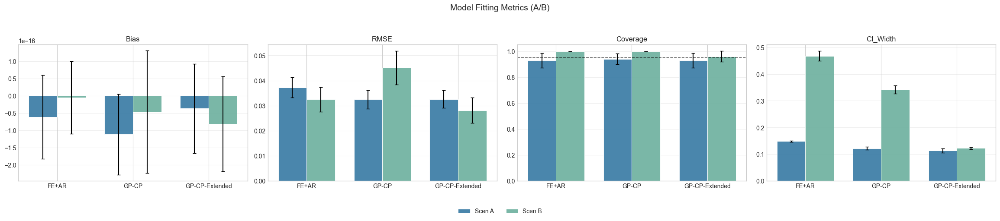

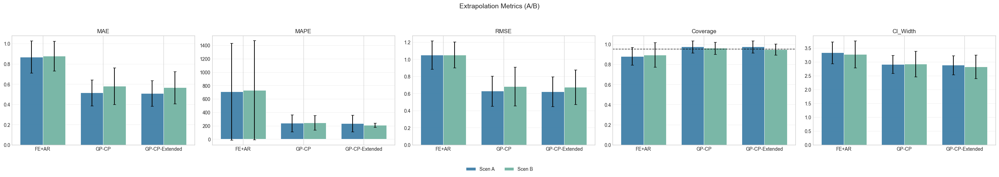

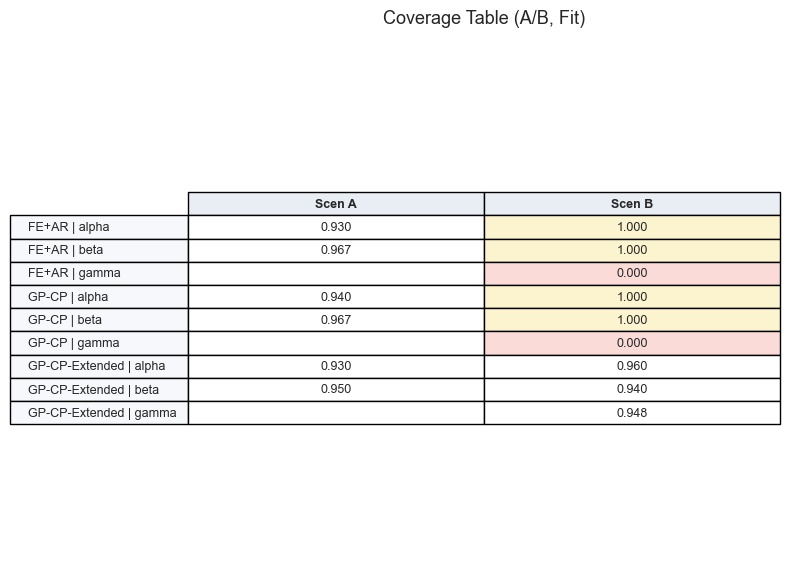

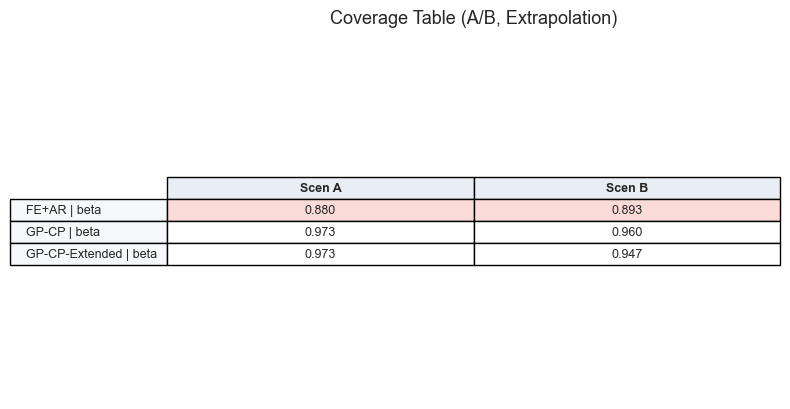

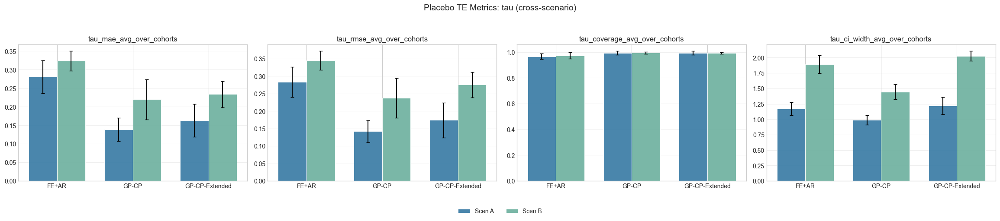

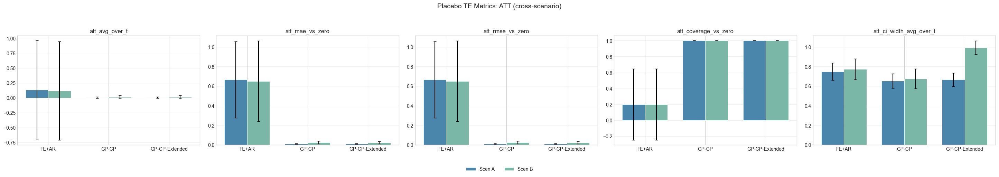

In [14]:
from src.visualization import plot_metric_summary, plot_coverage_table

if 'summary_all_df' not in globals:
 summary_all_df = pd.read_csv(SIM_ROOT / 'summary_ALL.csv')

# Separate fit vs extrapolation for readability
fit_df = summary_all_df[summary_all_df['task'].astype(str) == 'fit'].copy
ex_df = summary_all_df[summary_all_df['task'].astype(str) == 'extrapolation'].copy

plot_metric_summary(
 fit_df,
 task='fit',
 metrics=['Bias', 'RMSE', 'Coverage', 'CI_Width'],
 title='Model Fitting Metrics (A/B)',
 save_path=str(SIM_ROOT / 'summary_metrics_fit_barplot.pdf'),
)

plot_metric_summary(
 ex_df,
 task='extrapolation',
 metrics=['MAE', 'MAPE', 'RMSE', 'Coverage', 'CI_Width'],
 title='Extrapolation Metrics (A/B)',
 save_path=str(SIM_ROOT / 'summary_metrics_extrap_barplot.pdf'),
)

plot_coverage_table(
 fit_df,
 task='fit',
 title='Coverage Table (A/B, Fit)',
 save_path=str(SIM_ROOT / 'summary_coverage_table_fit.pdf'),
)

plot_coverage_table(
 ex_df,
 task='extrapolation',
 title='Coverage Table (A/B, Extrapolation)',
 save_path=str(SIM_ROOT / 'summary_coverage_table_extrap.pdf'),
)

print('Summary plots complete.')
print('Wrote:', SIM_ROOT / 'summary_metrics_fit_barplot.pdf')
print('Wrote:', SIM_ROOT / 'summary_metrics_extrap_barplot.pdf')
print('Wrote:', SIM_ROOT / 'summary_coverage_table_fit.pdf')
print('Wrote:', SIM_ROOT / 'summary_coverage_table_extrap.pdf')

# Placebo-only cross-scenario summaries (tau/ATT)
placebo_df = summary_all_df[summary_all_df['task'].astype(str) == 'placebo_te'].copy
if not placebo_df.empty:
 tau_metrics = [
  'tau_mae_avg_over_cohorts',
  'tau_rmse_avg_over_cohorts',
  'tau_coverage_avg_over_cohorts',
  'tau_ci_width_avg_over_cohorts',
 ]
 att_metrics = [
  'att_avg_over_t',
  'att_mae_vs_zero',
  'att_rmse_vs_zero',
  'att_coverage_vs_zero',
  'att_ci_width_avg_over_t',
 ]

 tau_df = placebo_df[placebo_df['metric'].astype(str).isin(tau_metrics)].copy
 att_df = placebo_df[placebo_df['metric'].astype(str).isin(att_metrics)].copy

 if not tau_df.empty:
  plot_metric_summary(
   tau_df,
   task='placebo_te',
   metrics=tau_metrics,
   title='Placebo TE Metrics: tau (cross-scenario)',
   save_path=str(SIM_ROOT / 'summary_metrics_placebo_tau_barplot.pdf'),
  )

 if not att_df.empty:
  plot_metric_summary(
   att_df,
   task='placebo_te',
   metrics=att_metrics,
   title='Placebo TE Metrics: ATT (cross-scenario)',
   save_path=str(SIM_ROOT / 'summary_metrics_placebo_att_barplot.pdf'),
  )

 summary_placebo_table_ab = (
  placebo_df
 .pivot_table(index=['model', 'metric'], columns='scenario', values='mean', aggfunc='first')
 .sort_index
 )
 summary_placebo_table_ab.to_csv(SIM_ROOT / 'summary_placebo_table.csv')
 (SIM_ROOT / 'summary_placebo_table.txt').write_text(summary_placebo_table_ab.to_string + "\n")

 print('Wrote:', SIM_ROOT / 'summary_metrics_placebo_tau_barplot.pdf')
 print('Wrote:', SIM_ROOT / 'summary_metrics_placebo_att_barplot.pdf')
 print('Wrote:', SIM_ROOT / 'summary_placebo_table.csv')
 print('Wrote:', SIM_ROOT / 'summary_placebo_table.txt')
